In [ ]:
!pip install torch torchvision pycocotools matplotlib


In [ ]:
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 37.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 73.8 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11


In [ ]:
!pip install opencv-python

In [ ]:
from roboflow import Roboflow

import os

import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T
from PIL import Image
import json
from torchvision import ops

import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

import torch
import time
from torch.optim.lr_scheduler import StepLR

from torchvision.ops import box_iou
from pycocotools.coco import COCO
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report


from google.colab.patches import cv2_imshow


# Carga de dataset versión 1

In [ ]:
rf = Roboflow(api_key="KEY")
project = rf.workspace("probando-ggup4").project("proyecto-cafe-dy6x4")
version = project.version(7)
dataset = version.download("coco")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Proyecto-Café-7 in coco:: 100%|██████████| 404/404 [00:00<00:00, 9887.55it/s]


# Carga de dataset versión 2

In [ ]:
rf = Roboflow(api_key="KEY")
project = rf.workspace("probando-ggup4").project("proyecto-cafe-dy6x4")
version = project.version(10)
dataset = version.download("coco")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Proyecto-Café-10 in coco:: 100%|██████████| 486/486 [00:00<00:00, 6530.86it/s]


# Funciones

**Formato COCO - formato para Pytorch**

In [ ]:
class COCODataset():

    def __init__(self, img_dir, ann_file, transforms=None):
        self.img_dir = img_dir
        self.transforms = transforms

        with open(ann_file) as f:
            self.coco = json.load(f)

        self.images = self.coco["images"]
        self.annotations = self.coco["annotations"]

        # Indexar anotaciones por id de imagen
        self.ann_map = {}
        for ann in self.annotations:
            img_id = ann["image_id"]
            if img_id not in self.ann_map:
                self.ann_map[img_id] = []
            self.ann_map[img_id].append(ann)

    def __getitem__(self, idx):
        img_info = self.images[idx]
        img_path = os.path.join(self.img_dir, img_info["file_name"])
        img = Image.open(img_path).convert("RGB")

        img_id = img_info["id"]
        anns = self.ann_map.get(img_id, [])

        boxes = []
        labels = []

        for ann in anns:
            x, y, w, h = ann["bbox"]
            boxes.append([x, y, x+w, y+h])
            labels.append(ann["category_id"])

        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([img_id]),
        }

        if self.transforms:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return len(self.images)


def collate_fn(batch):
    return tuple(zip(*batch))


**Creación de datasets para pytroch**

In [ ]:
def Dataset (image_dir, ann_file, batch_size, shuffle, collate_fn):
  #de imagen a tensor
  train_transforms = T.ToTensor()

  dataset = COCODataset(
      img_dir=image_dir,
      ann_file=ann_file,
      transforms=train_transforms
  )

  data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle, collate_fn=collate_fn)

  return data_loader

**Hiperparámetros y entrenamiento**

In [ ]:
def load_train(clss, model, optimizer, lr_scheduler, epoch, train_loader):

  num_classes = clss
  model = model
  in_features = model.roi_heads.box_predictor.cls_score.in_features
  model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

  device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
  model.to(device)

  optimizer = optimizer
  lr_scheduler = lr_scheduler

  num_epochs = epoch

  for epoch in range(num_epochs):
      model.train()
      loss_sum = 0

      start = time.time()

      for imgs, targets in train_loader:
          imgs = [img.to(device) for img in imgs]
          targets = [{k: v.to(device) for k,v in t.items()} for t in targets]

          loss_dict = model(imgs, targets)
          losses = sum(loss_dict.values())

          optimizer.zero_grad()
          losses.backward()
          optimizer.step()

          loss_sum += losses.item()

      lr_scheduler.step()

      print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss_sum:.4f}, Time: {time.time()-start:.1f}s")
  return model

**Solo carga de un modelo**

In [ ]:
def load_model(path, NUM_CLASSES):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn()
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, NUM_CLASSES)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.load_state_dict(torch.load(path, map_location=device))
    model.to(device)
    model.eval()
    return model

**Métricas para conjunto de imágenes**

In [ ]:
def metric_images(model, DATASET_JSON, IMAGES_DIR, umbral_pred, iou_threshold):
  # -----------------------------
  #  CARGAR COCO TEST
  # -----------------------------
  coco = COCO(DATASET_JSON)
  img_ids = coco.getImgIds()

  transform = T.Compose([T.ToTensor()])

  # -----------------------------
  #  ACUMULADORES PARA LA EVALUACIÓN
  # -----------------------------
  all_gt_labels = []
  all_pred_labels = []

  tp = 0
  tn = 0
  fp = 0
  fn = 0

  # -----------------------------
  #  LOOP SOBRE TODAS LAS IMÁGENES TEST
  # -----------------------------
  for img_id in img_ids:
    img_info = coco.loadImgs(img_id)[0]
    img_path = os.path.join(IMAGES_DIR, img_info["file_name"])

    # cargar imagen
    image = Image.open(img_path).convert("RGB")
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    img_tensor = transform(image).to(device)

    # predicción
    with torch.no_grad():
        pred = model([img_tensor])[0]

    pred_boxes = pred["boxes"].cpu()
    pred_scores = pred["scores"].cpu()
    pred_labels_raw = pred["labels"].cpu()

    # filtrar predicciones con score > umbral_pred
    keep = pred_scores > umbral_pred
    pred_boxes = pred_boxes[keep]
    pred_labels_raw = pred_labels_raw[keep]
    pred_scores = pred_scores[keep]

    # -----------------------------------
    # NMS
    # -----------------------------------
    if len(pred_boxes) > 0:
        keep_idx = ops.nms(pred_boxes, pred_scores, iou_threshold = iou_threshold)
        pred_boxes = pred_boxes[keep_idx]
        pred_labels_raw = pred_labels_raw[keep_idx]
        pred_scores = pred_scores[keep_idx]

    # GT
    ann_ids = coco.getAnnIds(imgIds=img_id)
    anns = coco.loadAnns(ann_ids)

    gt_boxes = []
    gt_labels = []

    for a in anns:
        x, y, w, h = a["bbox"]
        gt_boxes.append([x, y, x+w, y+h])
        gt_labels.append(a["category_id"])

    gt_boxes = torch.tensor(gt_boxes)

    # -----------------------------
    #  EVALUACIÓN POR IMAGEN
    # -----------------------------
    if len(gt_boxes) > 0 and len(pred_boxes) > 0:
        ious = box_iou(pred_boxes, gt_boxes)
        max_iou, matched_gt = ious.max(dim=1)

        for iou, pred_label, gt_i in zip(max_iou, pred_labels_raw, matched_gt):
            gt_label = gt_labels[gt_i]

            all_gt_labels.append(gt_label)
            all_pred_labels.append(pred_label.item())


            if pred_label.item() ==1 and 1 == gt_label:
                tp += 1
            elif pred_label.item() ==2 and 2 == gt_label:
                tn += 1
            elif pred_label.item() == 1 and 2 == gt_label:
                fn += 1
            elif pred_label.item() == 2 and 1 == gt_label:
                fp += 1

            if len(gt_boxes) > len(pred_boxes):
                # si GT existe y no hubo predicciones → FP
                a += len(gt_boxes) - len(pred_boxes)
        # FN = GT no matcheados
            fn += max(0, len(gt_boxes) - (max_iou >= 0.5).sum().item())

    else:
        # si GT existe y no hubo predicciones → FN
        a += len(gt_boxes)

  # -----------------------------
  #  MÉTRICAS FINALES
  # -----------------------------
  print("\n==============================")
  print("       MÉTRICAS FINALES")
  print("==============================\n")

  precision = tp / (tp + fp + 1e-6)
  recall = tp / (tp + fn + 1e-6)
  f1 = 2 * precision * recall / (precision + recall + 1e-6)

  print(f"Precision global: {precision:.3f}")
  print(f"Recall global:    {recall:.3f}")
  print(f"F1 global:        {f1:.3f}")

  # MATRIZ DE CONFUSIÓN
  cm = confusion_matrix(all_gt_labels, all_pred_labels, labels=[1,2])
  print("\nMatriz de confusión (adecuado / defectuoso):")
  print(cm)

  # CLASIFICATION REPORT
  print("\nReporte de clasificación:\n")
  print(classification_report(all_gt_labels, all_pred_labels, target_names=["adecuado","defectuoso"]))


# Versión 1

## Entrenamiento versión 1

In [ ]:
train_loader = Dataset(dataset.location + "/train", dataset.location + "/train/_annotations.coco.json", batch_size = 4, shuffle = True,collate_fn=collate_fn)
valid_loader = Dataset(dataset.location + "/valid", dataset.location + "/valid/_annotations.coco.json", batch_size = 4, shuffle = False,collate_fn=collate_fn)

In [ ]:
CLASSES = ["background", "adecuado", "defectuoso"]  # ID 1 y 2
NUM_CLASSES = 3

model = torchvision.models.detection.fasterrcnn_resnet50_fpn()

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
lr_scheduler = StepLR(optimizer, step_size=5, gamma=0.1)

num_epochs = 20

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 121MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu

In [ ]:
model = load_train(NUM_CLASSES, model, optimizer, lr_scheduler, num_epochs, train_loader)

### Guardar modelo

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
save_path = "RUTA/fasterrcnn_cafe.pth"
torch.save(model.state_dict(), save_path)
print("Modelo guardado en:", save_path)


Modelo guardado en: /content/drive/MyDrive/UR/Vision/proyecto version fasster/fasterrcnn_cafe.pth


## Métricas versión 1

In [ ]:
# -----------------------------
#  CONFIGURACIÓN
# -----------------------------
MODEL_PATH = "/content/fasterrcnn_cafe.pth"
DATASET_JSON = "/content/Proyecto-Café-7/test/_annotations.coco.json"
IMAGES_DIR = "/content/Proyecto-Café-7/test"

model = load_model(MODEL_PATH,3)

In [ ]:
metric_images(model, DATASET_JSON, IMAGES_DIR, umbral_pred = 0.5, iou_threshold = 0.5)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!

       MÉTRICAS FINALES

Precision global: 0.931
Recall global:    0.868
F1 global:        0.899

Matriz de confusión (adecuado / defectuoso):
[[257  19]
 [ 39  87]]

Reporte de clasificación:

              precision    recall  f1-score   support

    adecuado       0.87      0.93      0.90       276
  defectuoso       0.82      0.69      0.75       126

    accuracy                           0.86       402
   macro avg       0.84      0.81      0.82       402
weighted avg       0.85      0.86      0.85       402



# Versión 2

## Entrenamiento versión 2

In [ ]:
train_loader = Dataset(dataset.location + "/train", dataset.location + "/train/_annotations.coco.json", batch_size = 4, shuffle = True,collate_fn=collate_fn)
valid_loader = Dataset(dataset.location + "/valid", dataset.location + "/valid/_annotations.coco.json", batch_size = 4, shuffle = False,collate_fn=collate_fn)

In [ ]:
CLASSES = ["background", "adecuado", "defectuoso"]  # ID 1 y 2
NUM_CLASSES = 3

model = torchvision.models.detection.fasterrcnn_resnet50_fpn()

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
lr_scheduler = StepLR(optimizer, step_size=5, gamma=0.1)

num_epochs = 20

In [ ]:
model = load_train(NUM_CLASSES, model, optimizer, lr_scheduler, num_epochs, train_loader)

Epoch 1/20, Loss: 98.3850, Time: 87.5s
Epoch 2/20, Loss: 45.0236, Time: 90.1s
Epoch 3/20, Loss: 36.6435, Time: 90.1s
Epoch 4/20, Loss: 34.8964, Time: 90.2s
Epoch 5/20, Loss: 31.3901, Time: 89.7s
Epoch 6/20, Loss: 23.6986, Time: 88.9s
Epoch 7/20, Loss: 21.8618, Time: 88.8s
Epoch 8/20, Loss: 21.3361, Time: 88.8s
Epoch 9/20, Loss: 20.7205, Time: 88.9s
Epoch 10/20, Loss: 19.8944, Time: 89.0s
Epoch 11/20, Loss: 18.9274, Time: 88.9s
Epoch 12/20, Loss: 18.7008, Time: 88.9s
Epoch 13/20, Loss: 18.4938, Time: 89.0s
Epoch 14/20, Loss: 18.5410, Time: 88.9s
Epoch 15/20, Loss: 18.4440, Time: 88.8s
Epoch 16/20, Loss: 18.3730, Time: 88.9s
Epoch 17/20, Loss: 18.2257, Time: 88.9s
Epoch 18/20, Loss: 18.3054, Time: 88.9s
Epoch 19/20, Loss: 18.2533, Time: 88.8s
Epoch 20/20, Loss: 18.2554, Time: 88.9s


In [ ]:
model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=1e-05)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=1e-05)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=1e-05)
          (relu

## Guardar modelo

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
save_path = "RUTA/fasterrcnn_cafe2.pth"
torch.save(model.state_dict(), save_path)
print("Modelo guardado en:", save_path)

Modelo guardado en: /content/drive/MyDrive/UR/Vision/proyecto version fasster/fasterrcnn_cafe2.pth


### Métricas versión 2

In [ ]:
# -----------------------------
#  CONFIGURACIÓN
# -----------------------------
MODEL_PATH = "/content/fasterrcnn_cafe2.pth"
DATASET_JSON = "/content/Proyecto-Café-10/test/_annotations.coco.json"
IMAGES_DIR = "/content/Proyecto-Café-10/test"

model = load_model(MODEL_PATH,3)

In [ ]:
metric_images(model, DATASET_JSON, IMAGES_DIR, umbral_pred = 0.5, iou_threshold = 0.5)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!

       MÉTRICAS FINALES

Precision global: 0.949
Recall global:    0.889
F1 global:        0.918

Matriz de confusión (adecuado / defectuoso):
[[337  18]
 [ 42 118]]

Reporte de clasificación:

              precision    recall  f1-score   support

    adecuado       0.89      0.95      0.92       355
  defectuoso       0.87      0.74      0.80       160

    accuracy                           0.88       515
   macro avg       0.88      0.84      0.86       515
weighted avg       0.88      0.88      0.88       515



# Videos

Procesando frame 1...


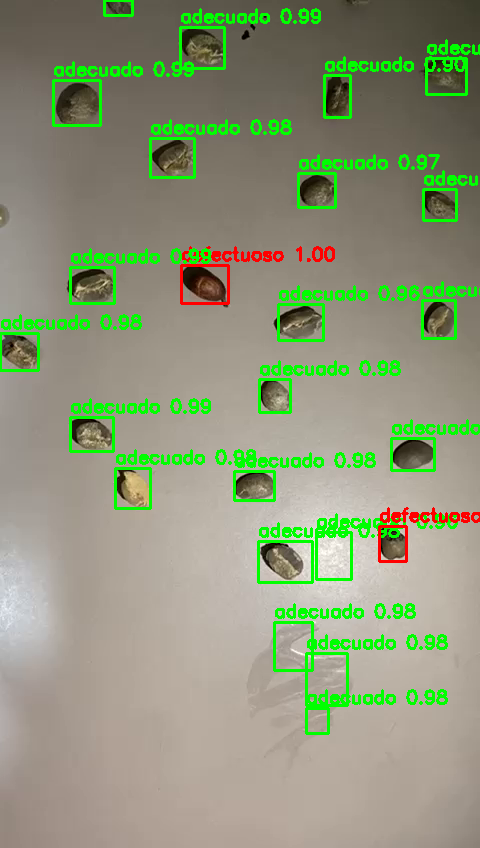

Procesando frame 2...


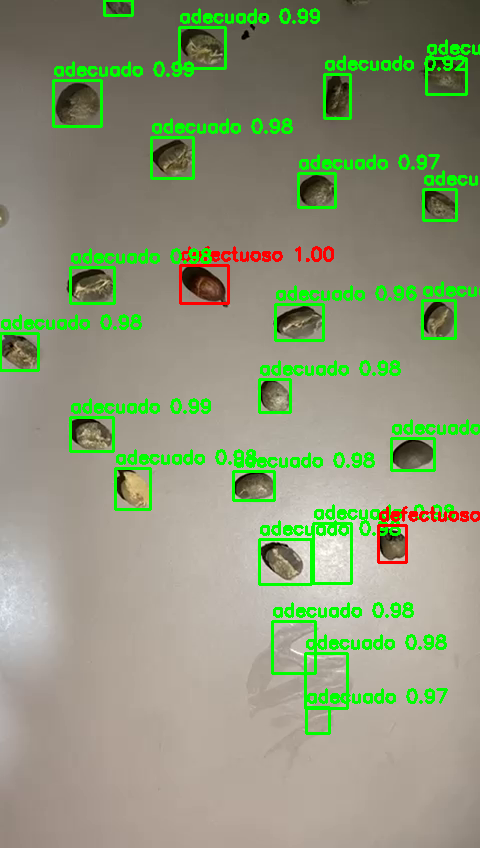

Procesando frame 3...


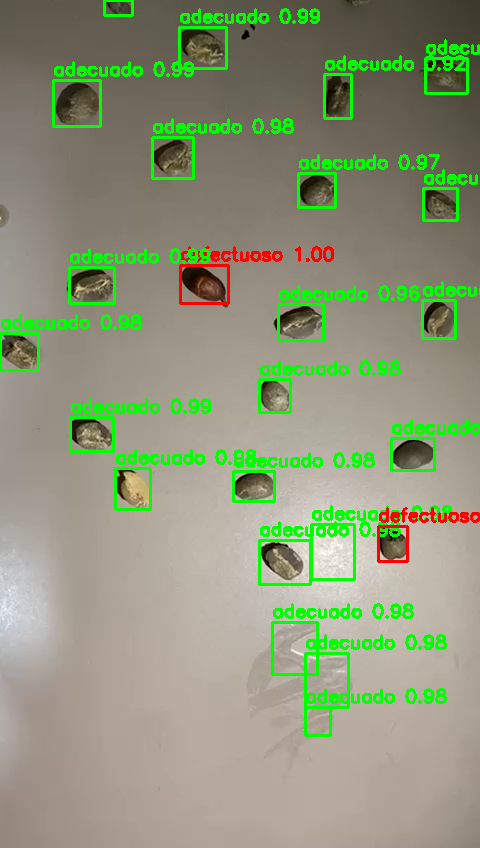

Procesando frame 4...


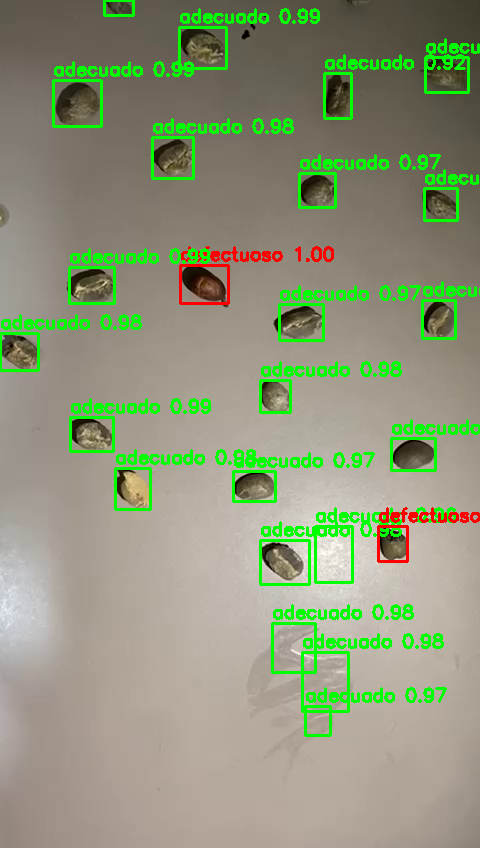

Procesando frame 5...


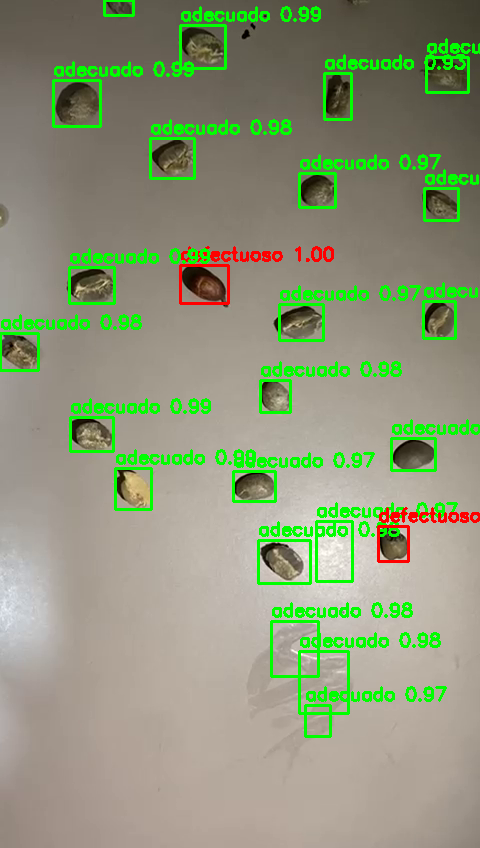

Procesando frame 6...


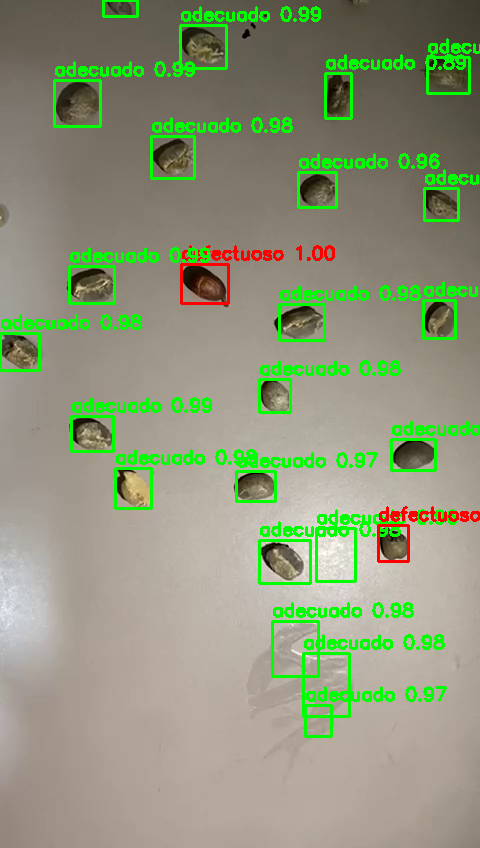

Procesando frame 7...


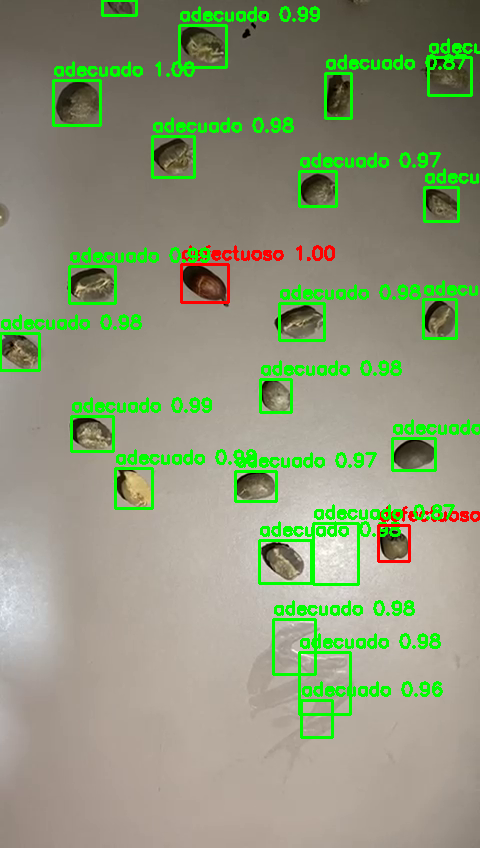

Procesando frame 8...


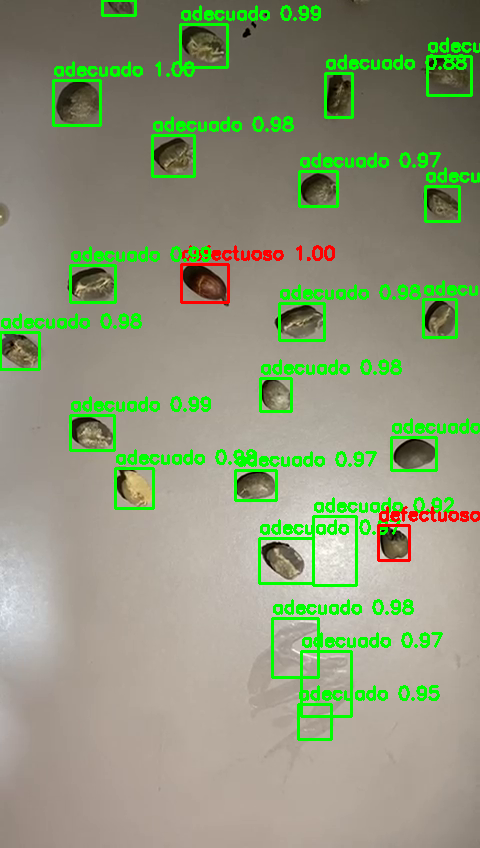

Procesando frame 9...


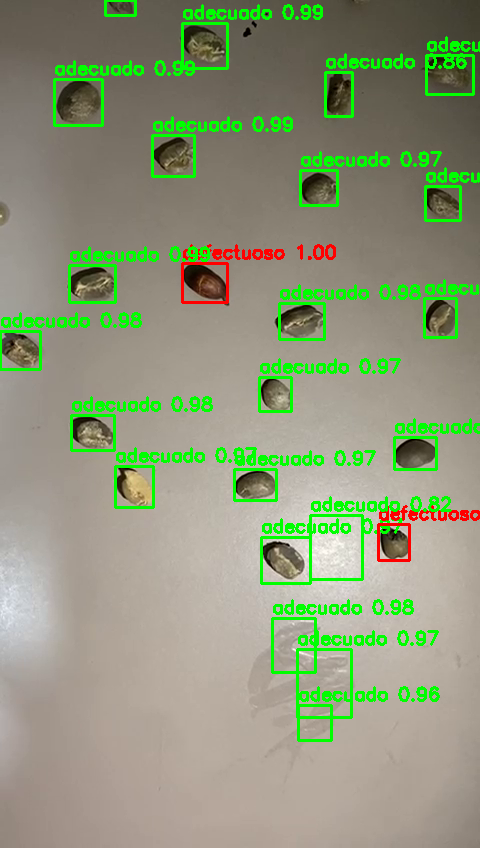

Procesando frame 10...


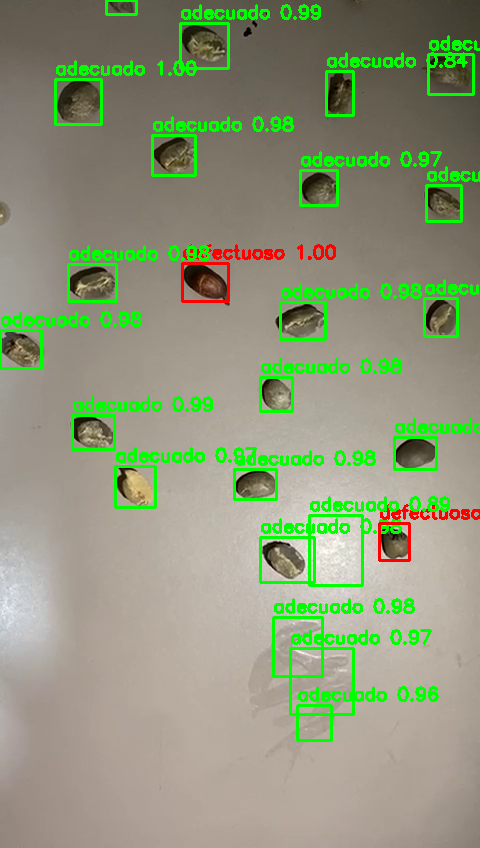

Procesando frame 11...


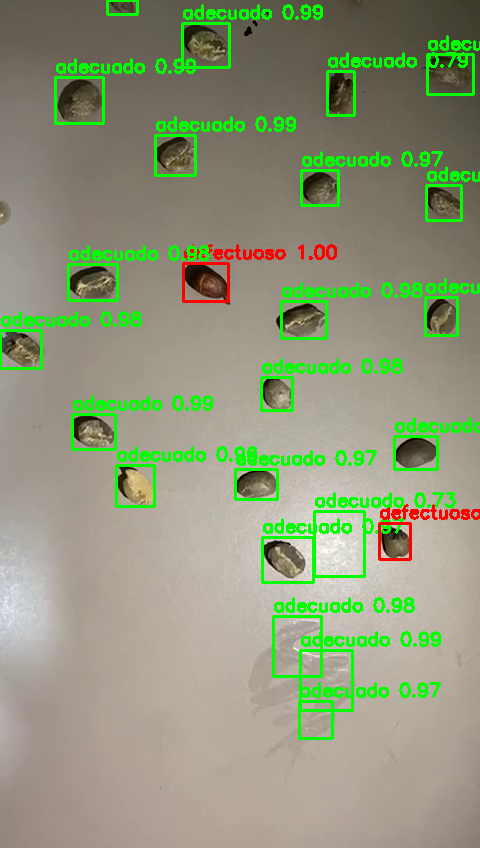

Procesando frame 12...


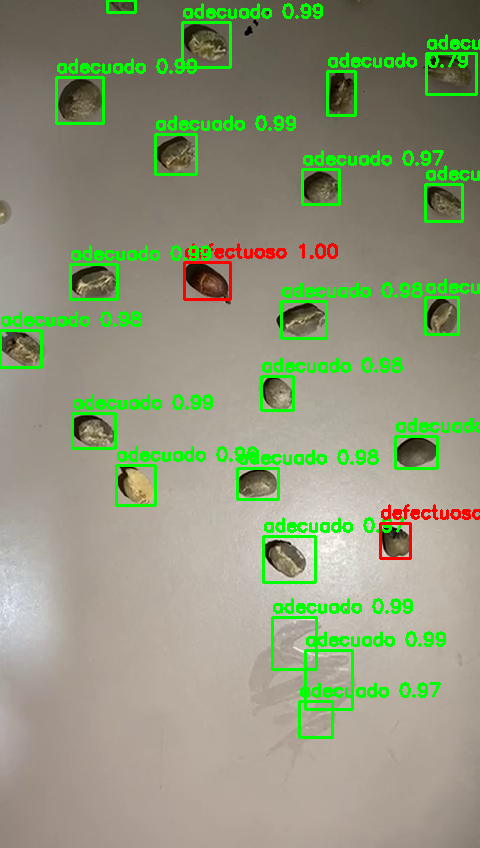

Procesando frame 13...


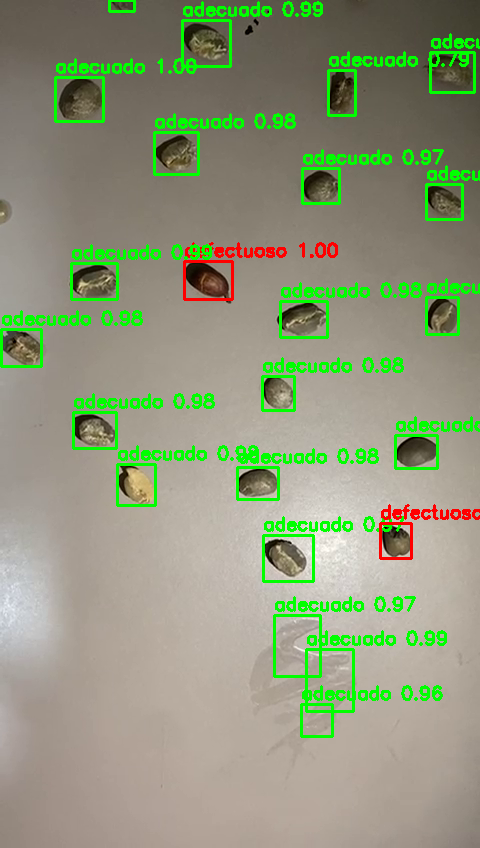

Procesando frame 14...


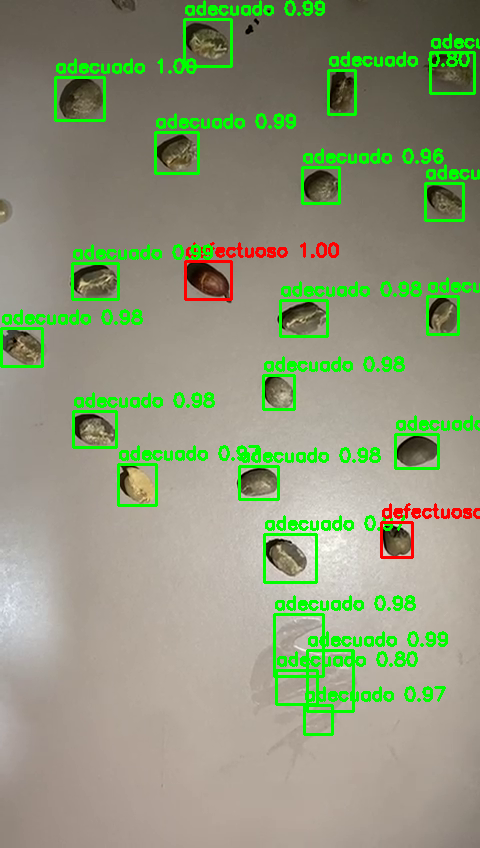

Procesando frame 15...


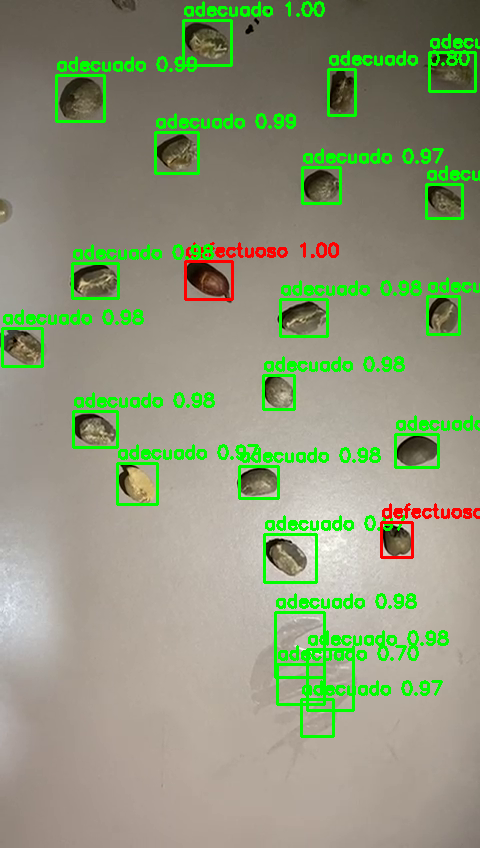

Procesando frame 16...


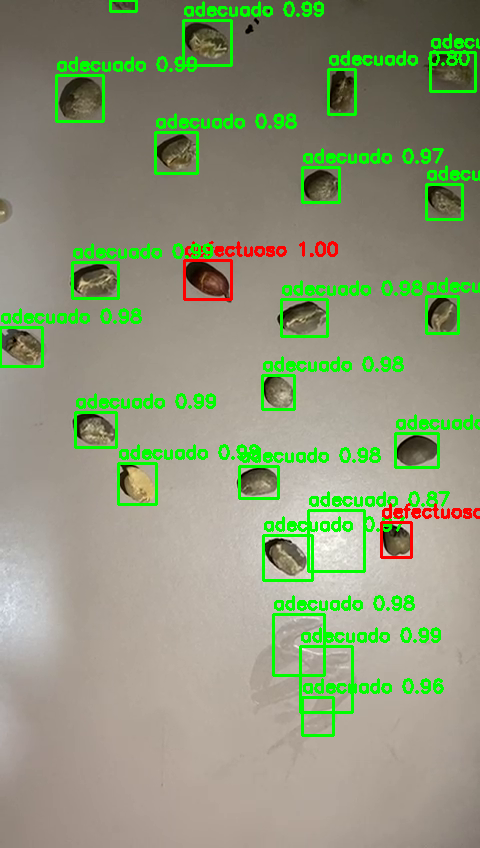

Procesando frame 17...


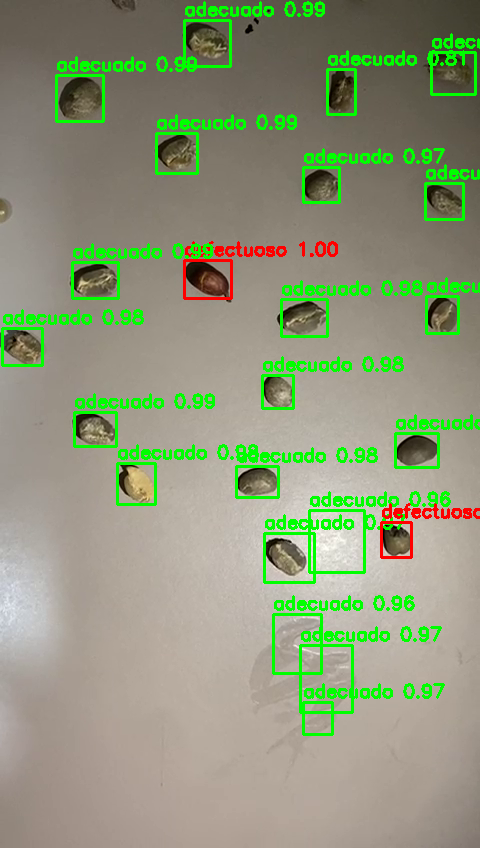

Procesando frame 18...


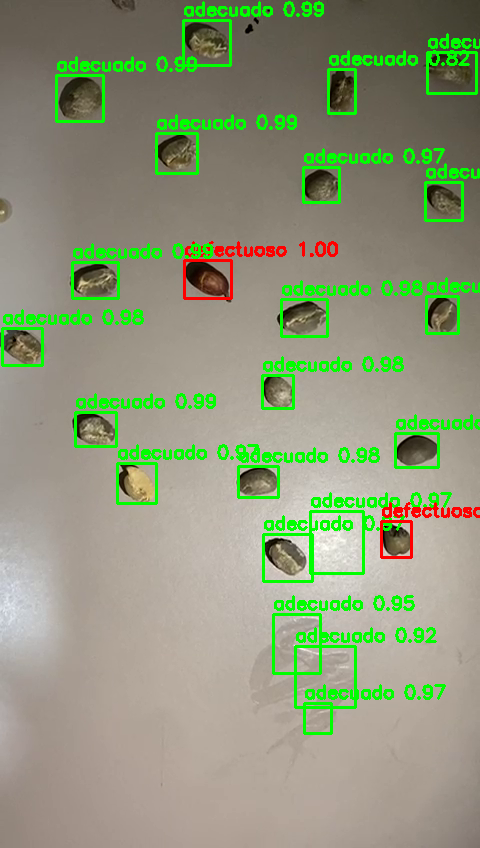

Procesando frame 19...


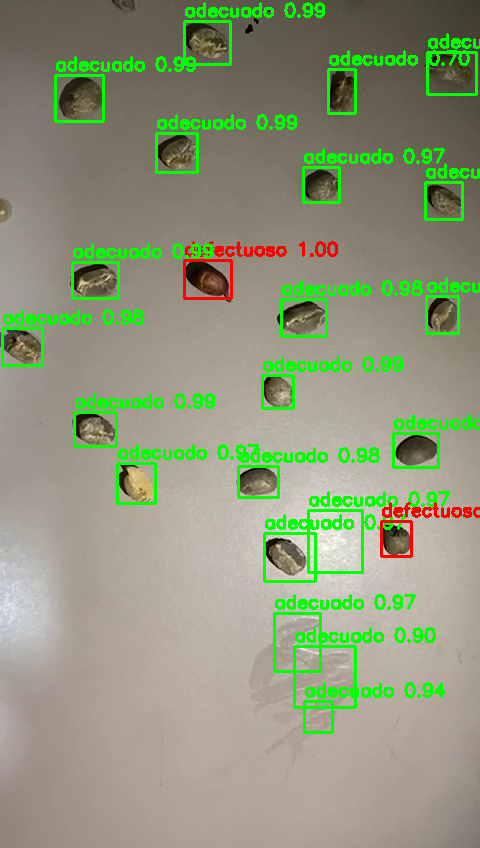

Procesando frame 20...


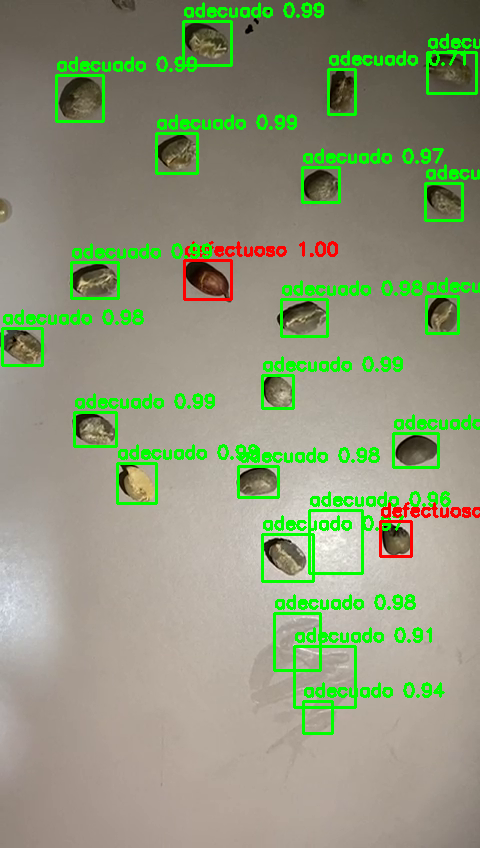

Procesando frame 21...


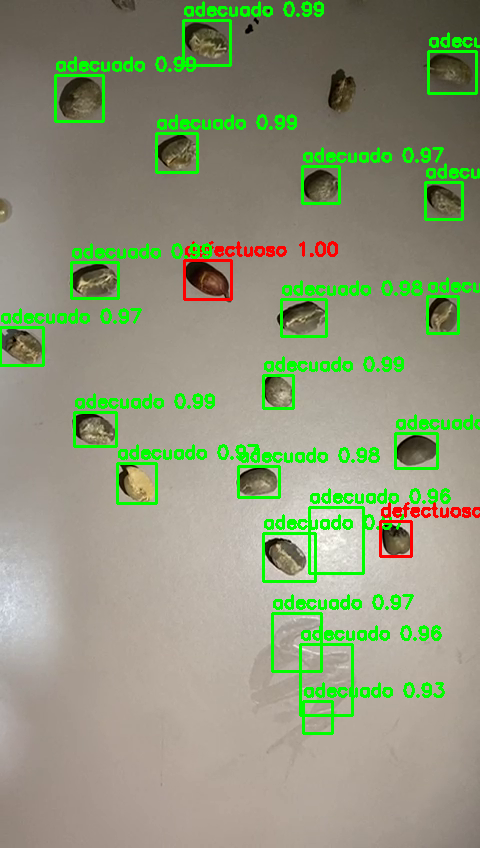

Procesando frame 22...


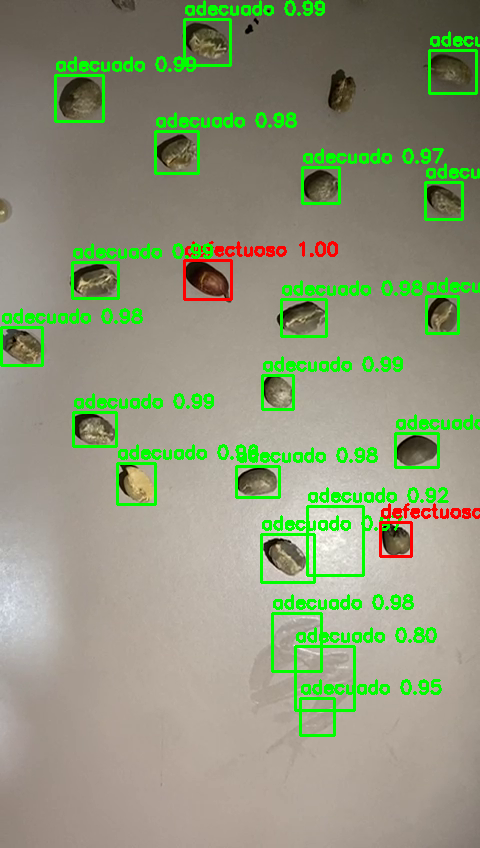

Procesando frame 23...


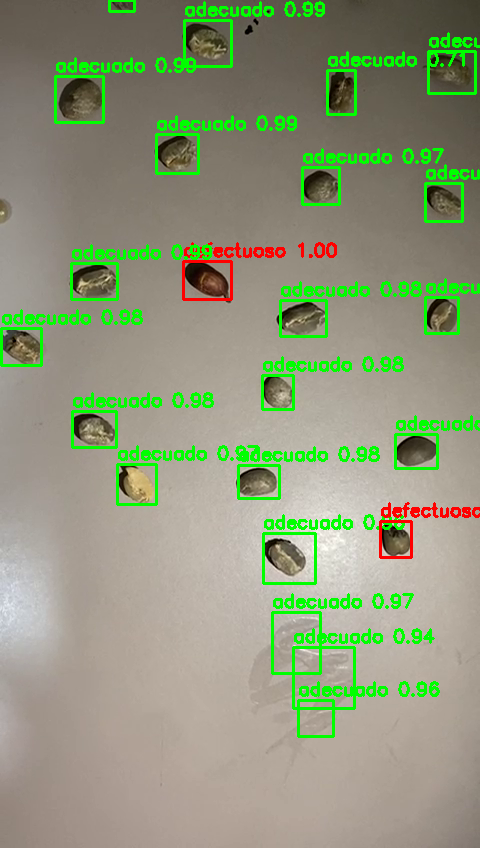

Procesando frame 24...


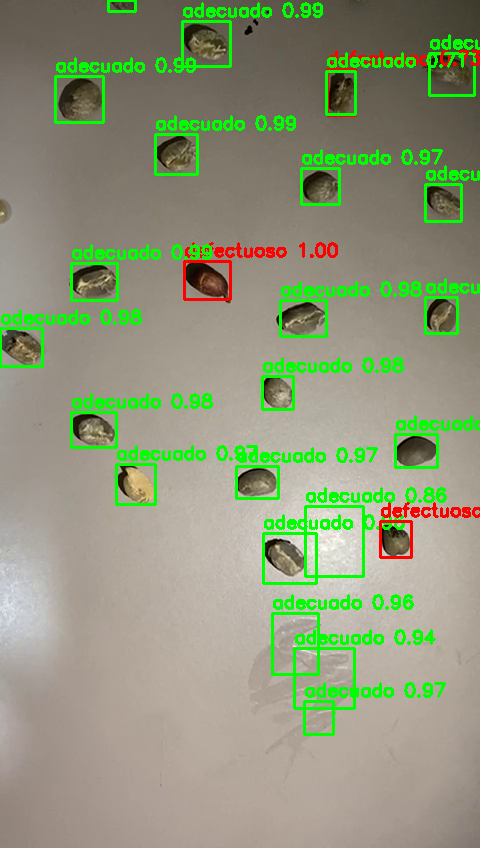

Procesando frame 25...


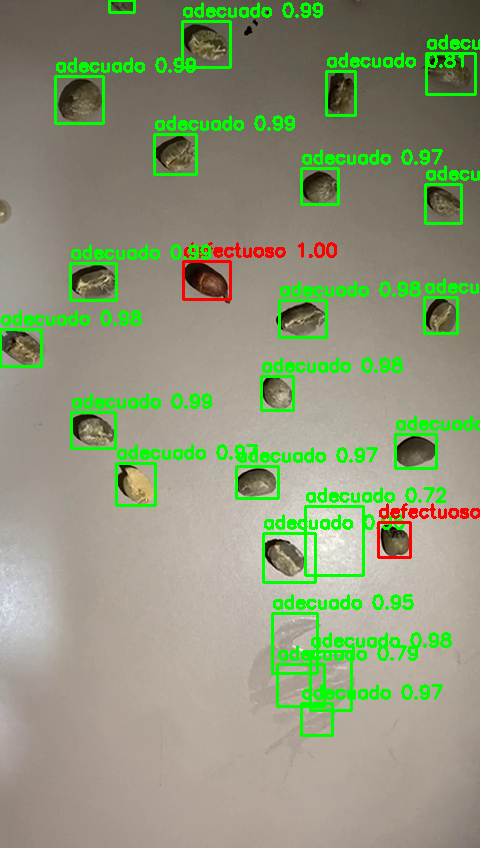

Procesando frame 26...


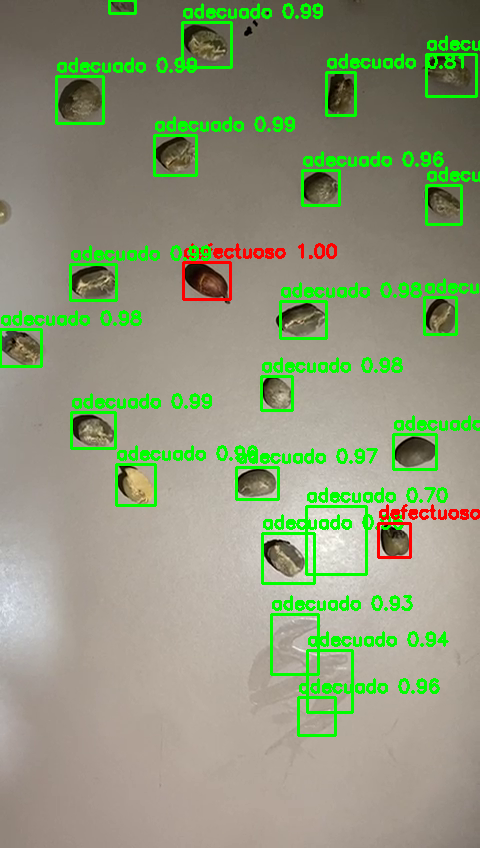

Procesando frame 27...


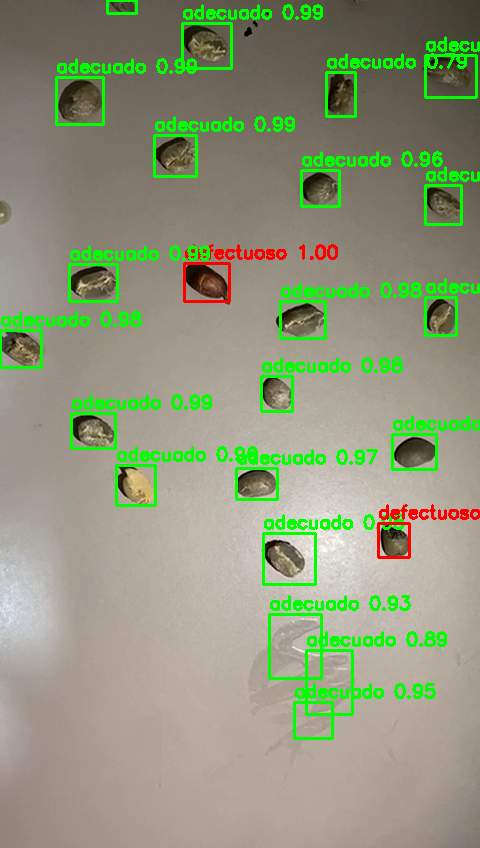

Procesando frame 28...


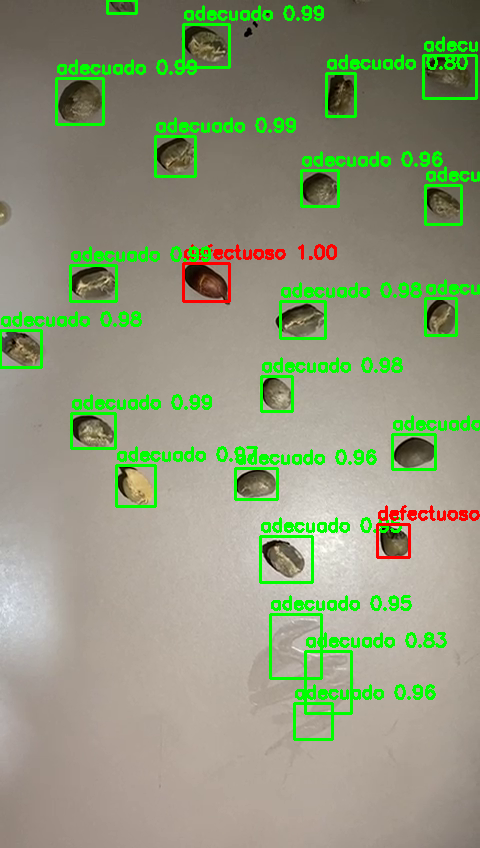

Procesando frame 29...


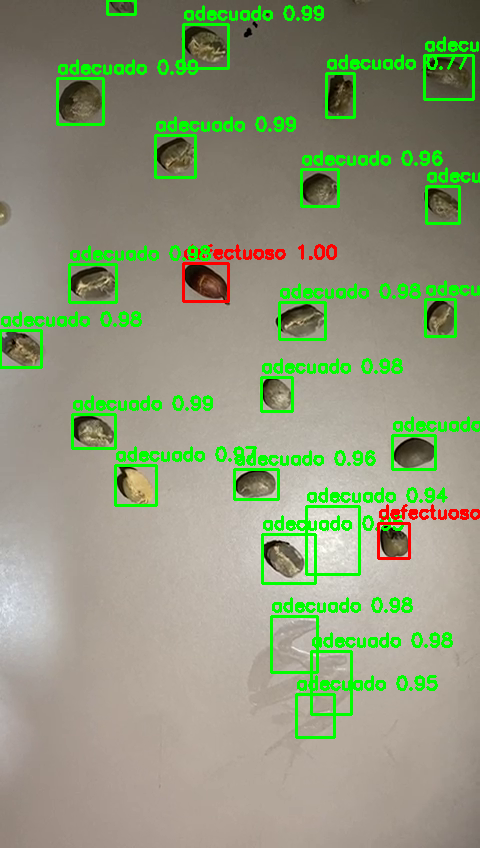

Procesando frame 30...


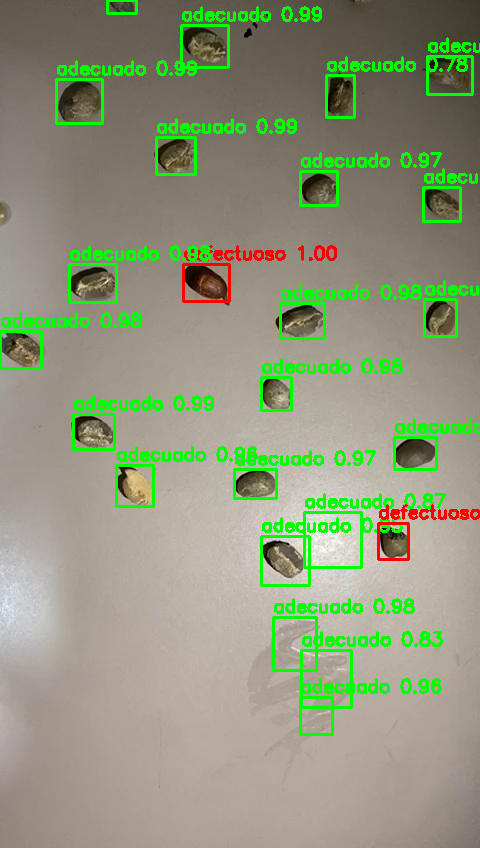

Procesando frame 31...


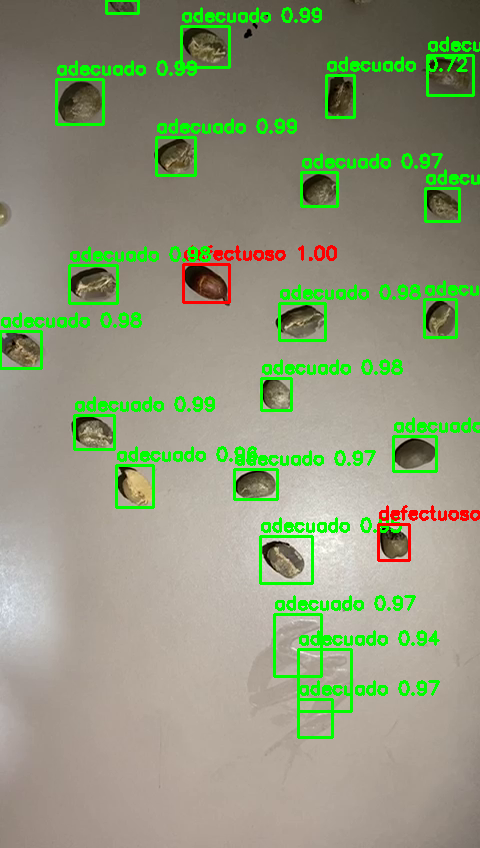

Procesando frame 32...


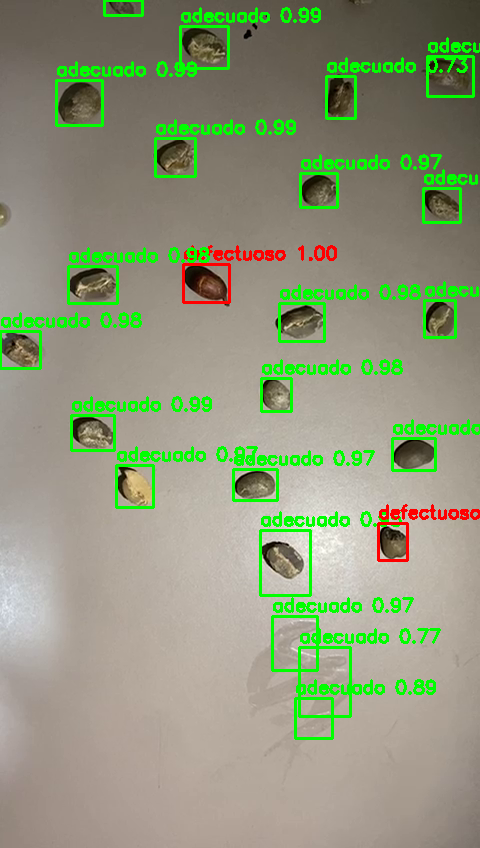

Procesando frame 33...


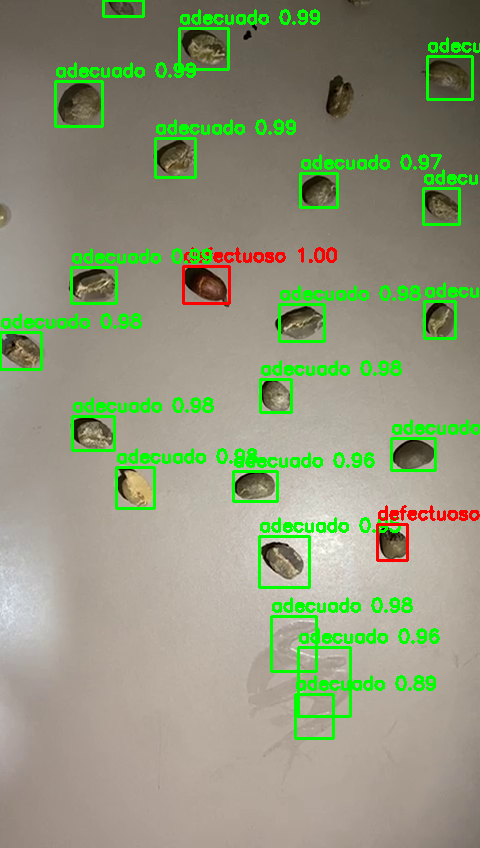

Procesando frame 34...


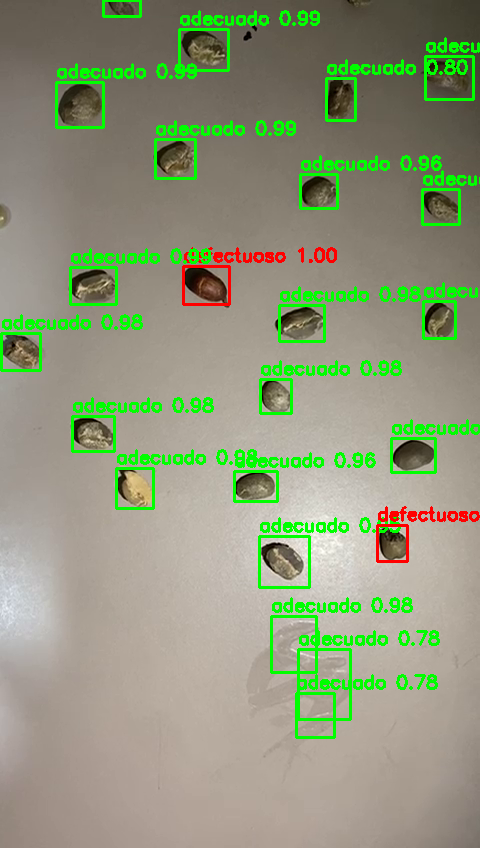

Procesando frame 35...


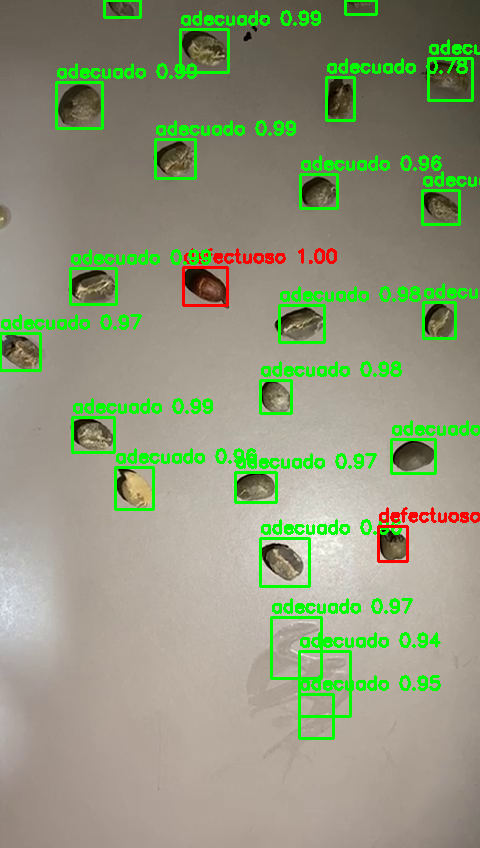

Procesando frame 36...


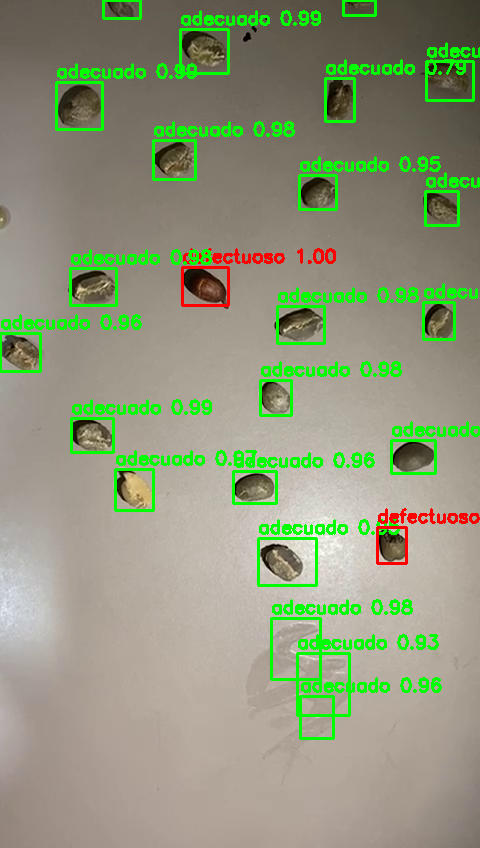

Procesando frame 37...


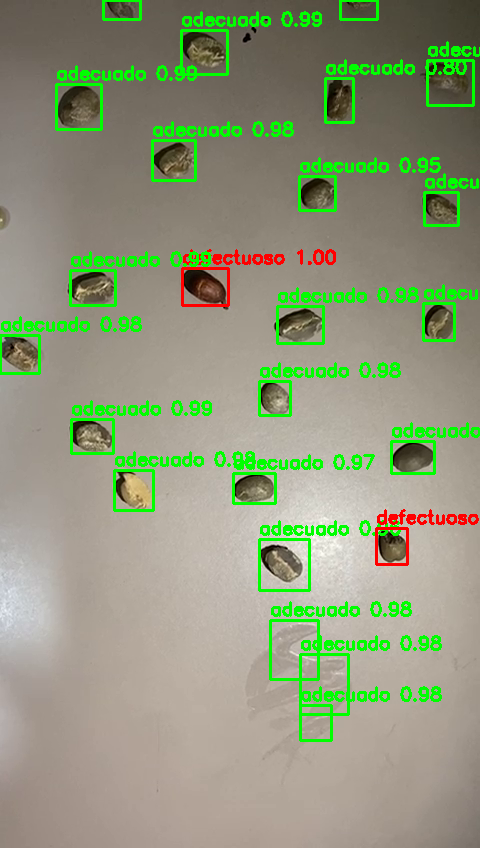

Procesando frame 38...


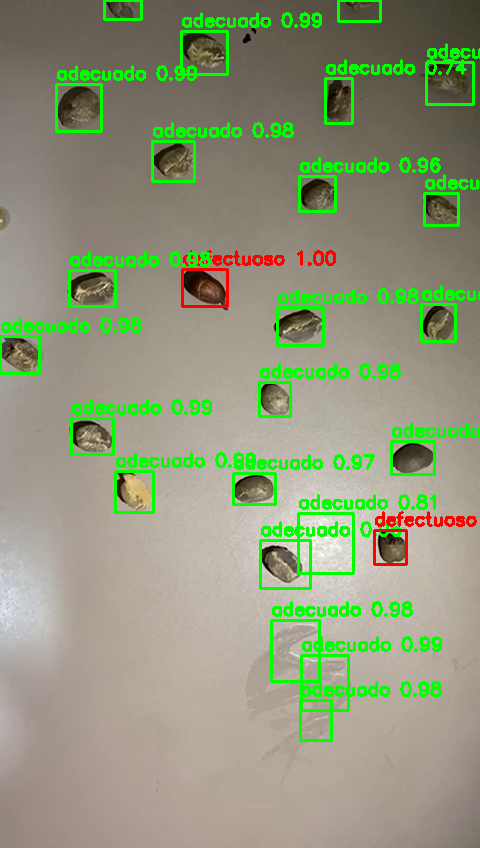

Procesando frame 39...


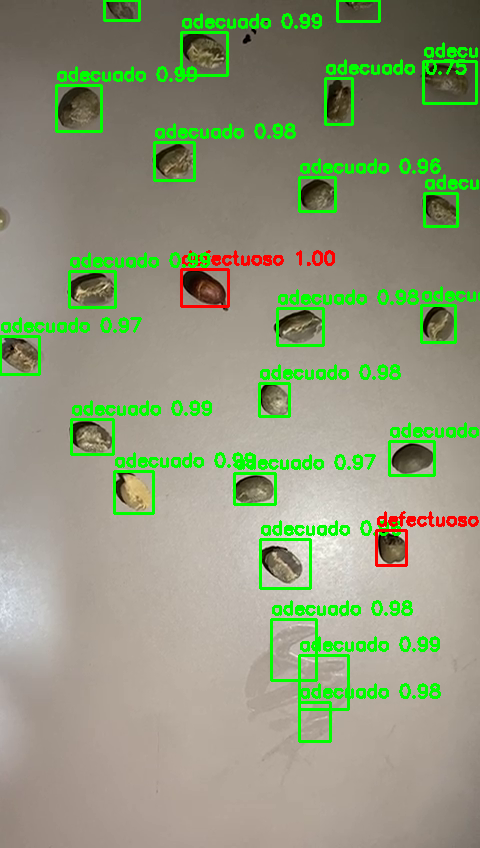

Procesando frame 40...


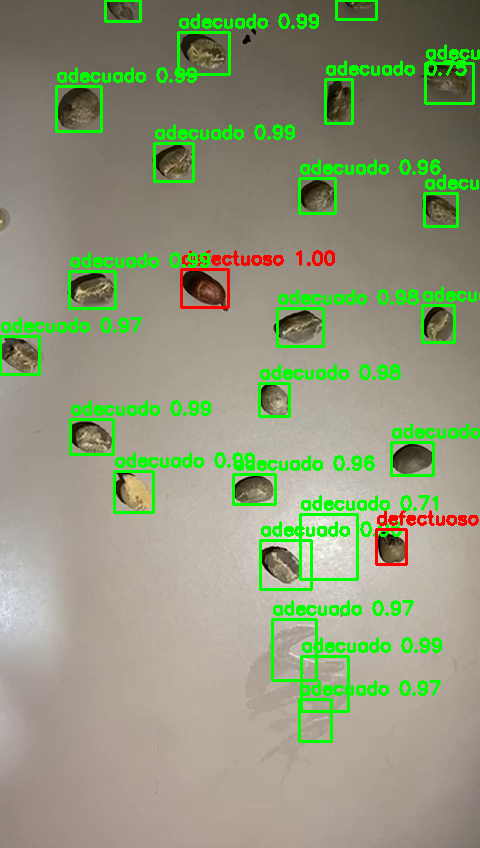

Procesando frame 41...


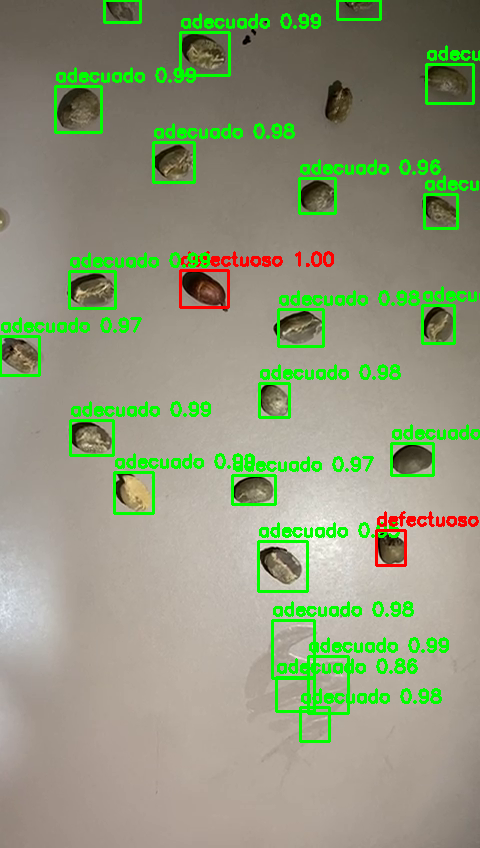

Procesando frame 42...


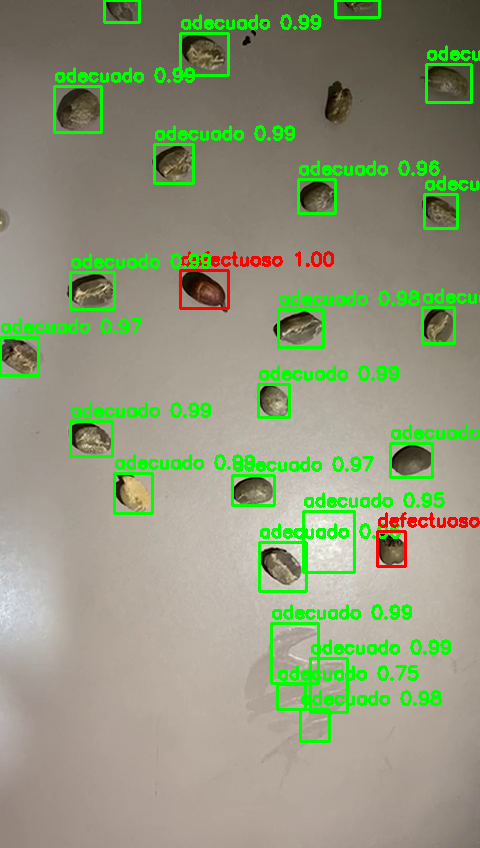

Procesando frame 43...


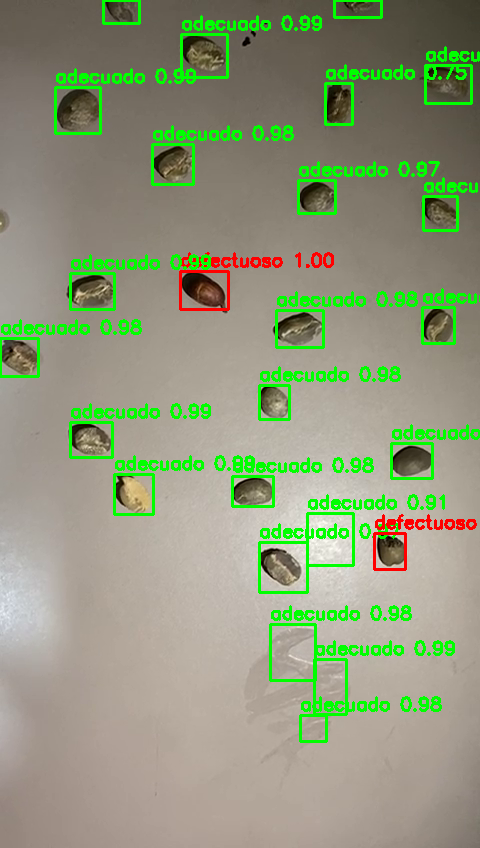

Procesando frame 44...


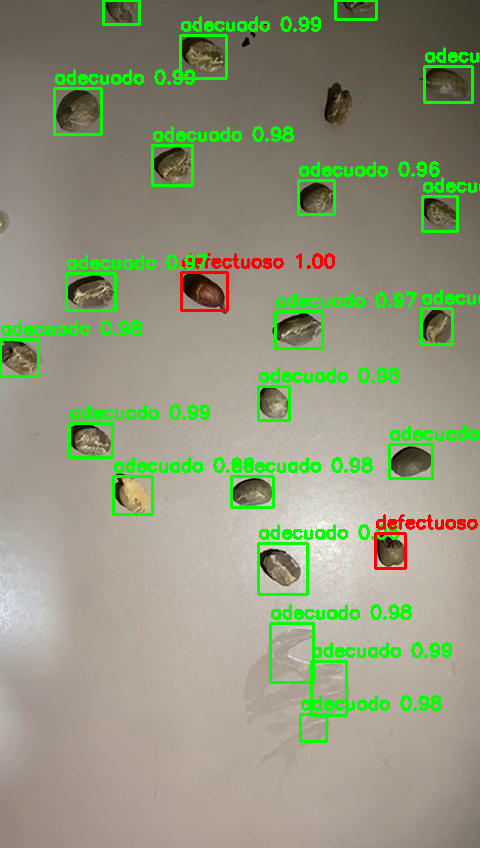

Procesando frame 45...


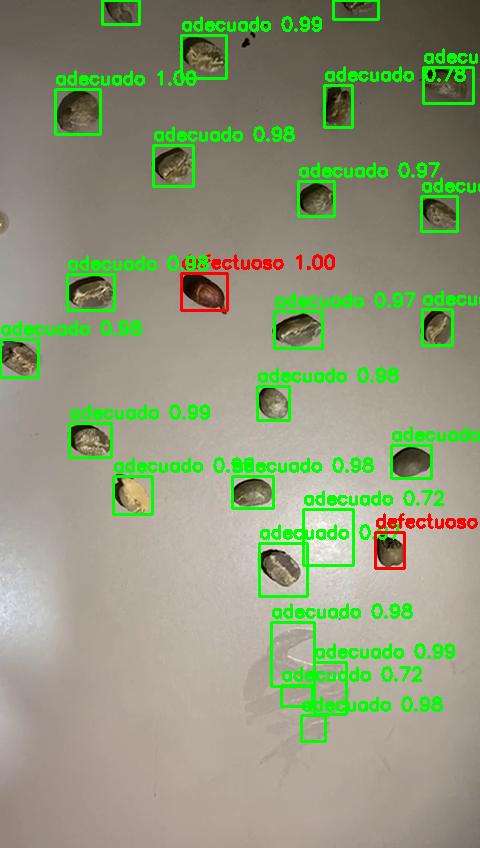

Procesando frame 46...


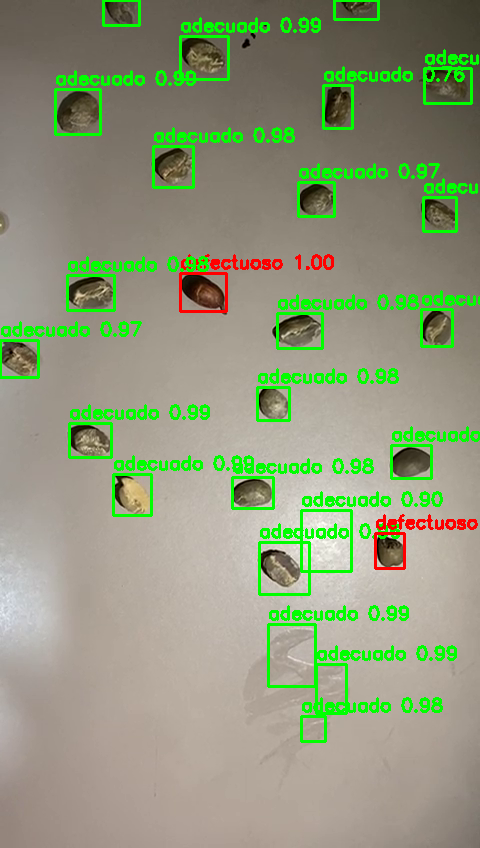

Procesando frame 47...


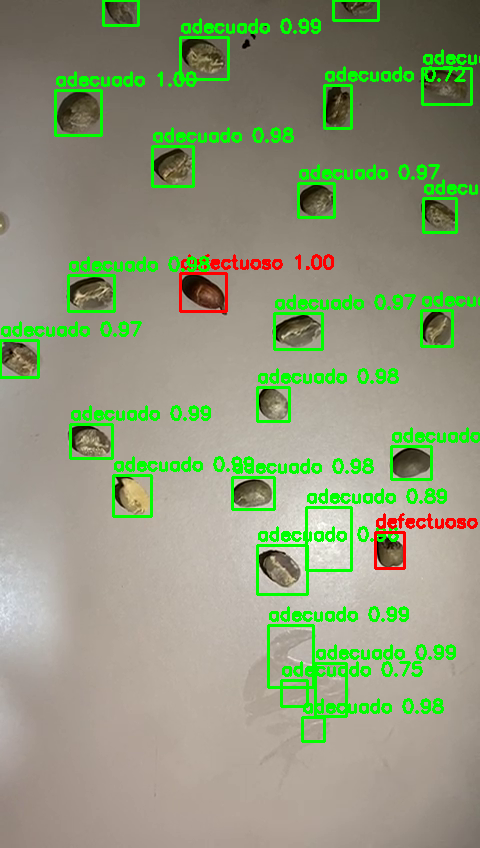

Procesando frame 48...


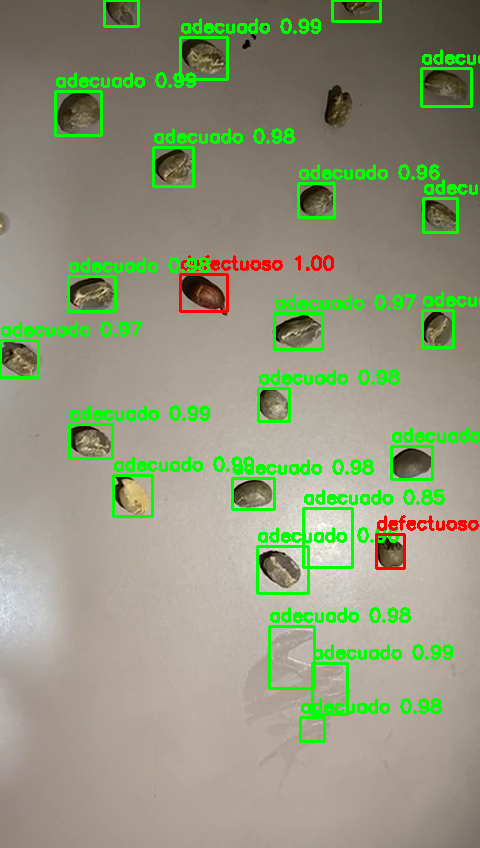

Procesando frame 49...


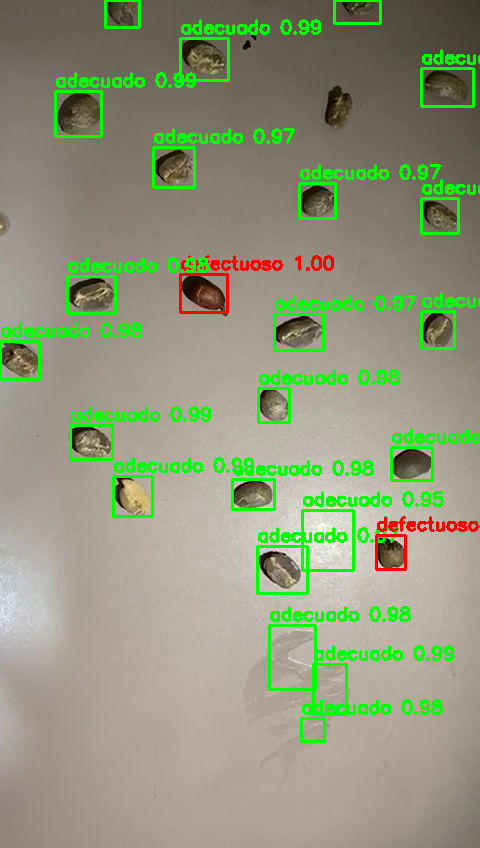

Procesando frame 50...


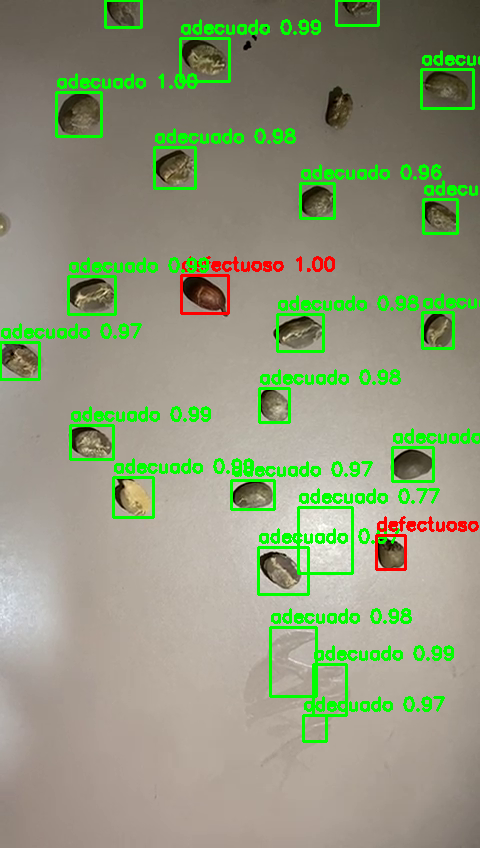

Procesando frame 51...


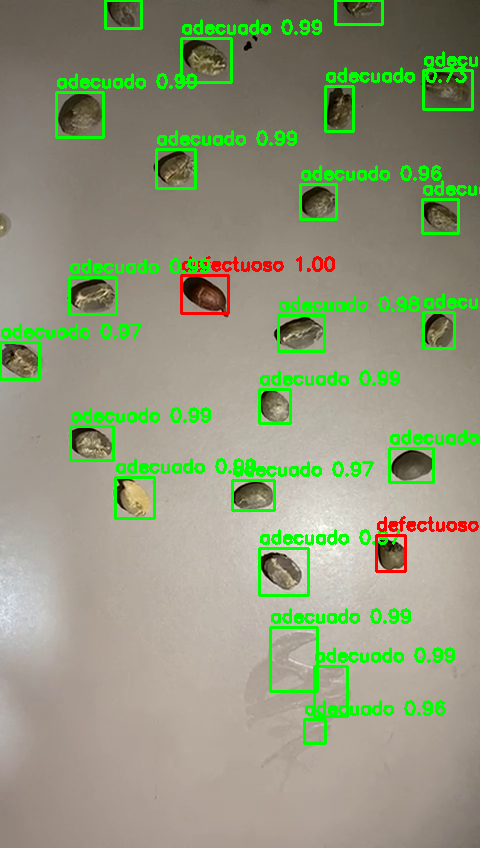

Procesando frame 52...


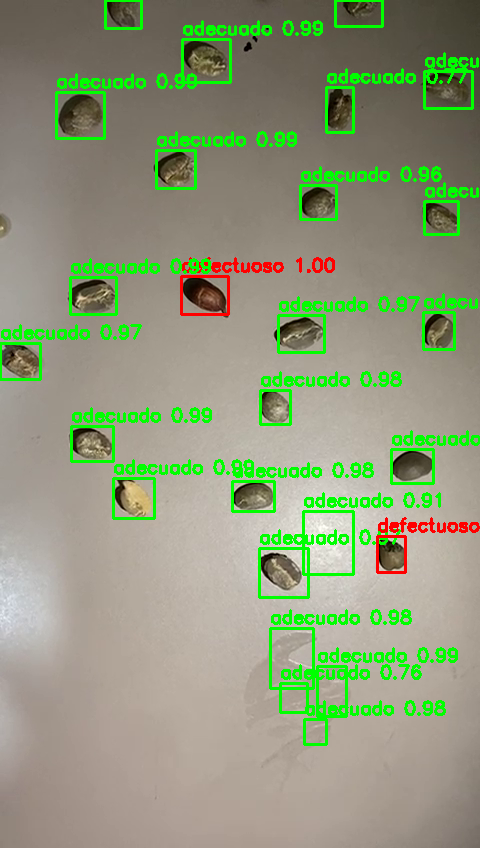

Procesando frame 53...


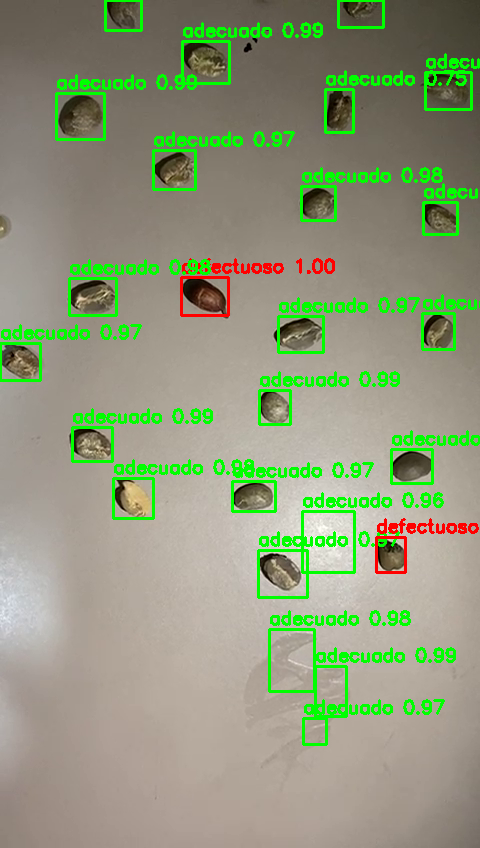

Procesando frame 54...


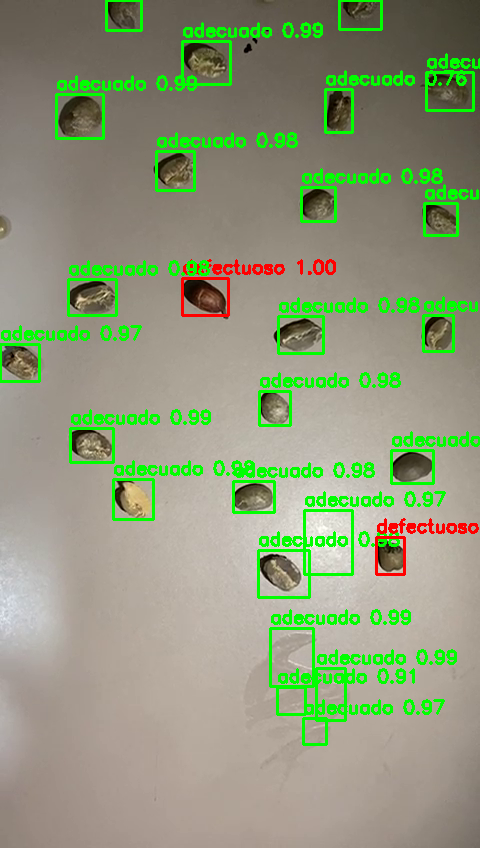

Procesando frame 55...


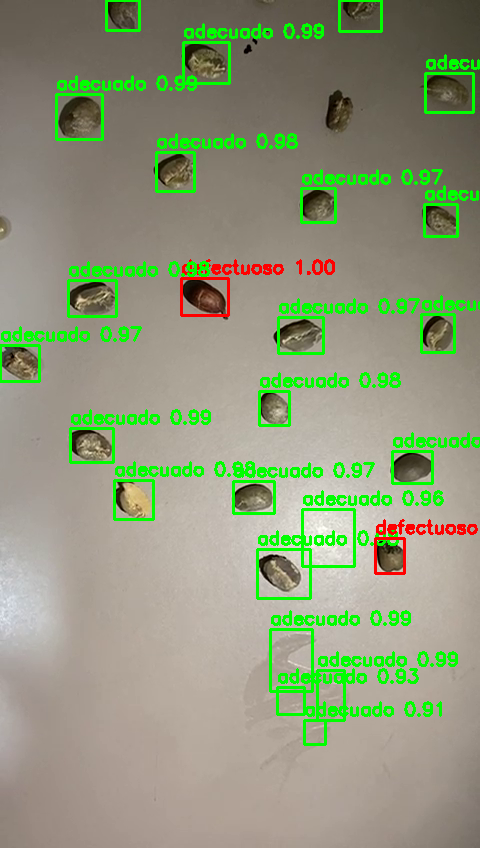

Procesando frame 56...


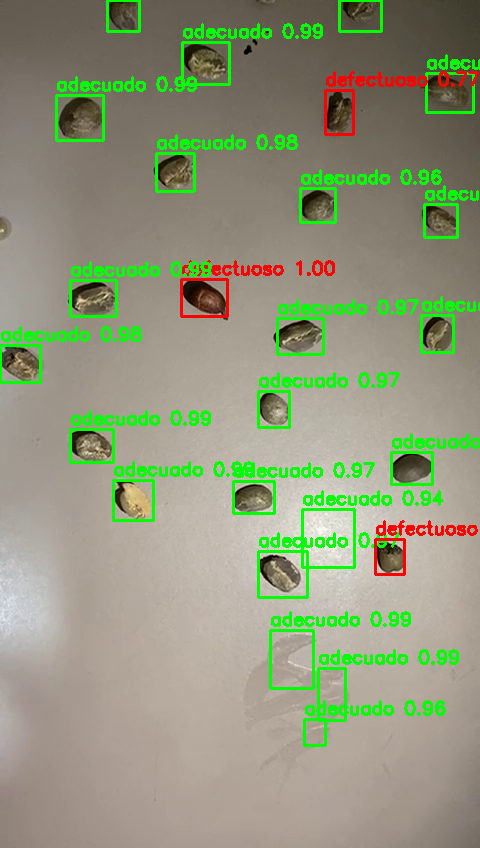

Procesando frame 57...


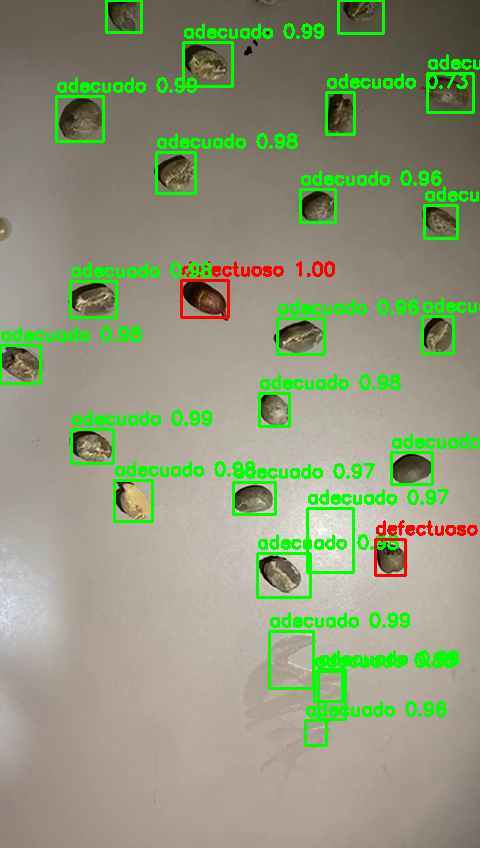

Procesando frame 58...


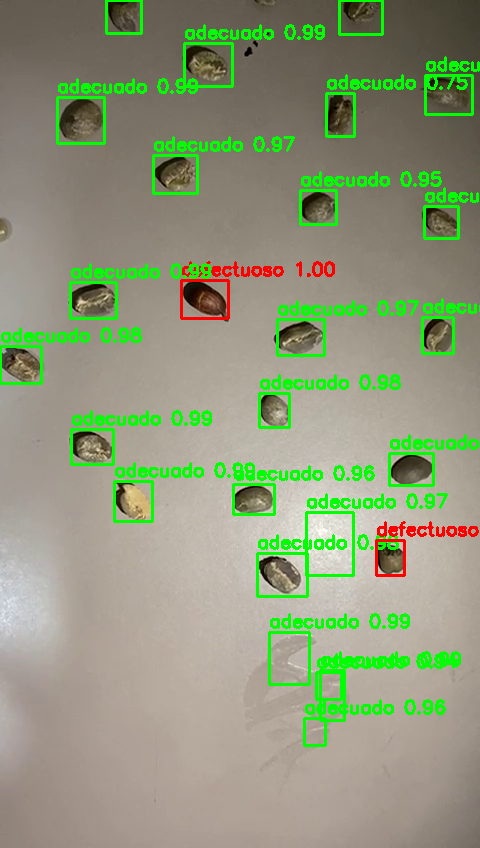

Procesando frame 59...


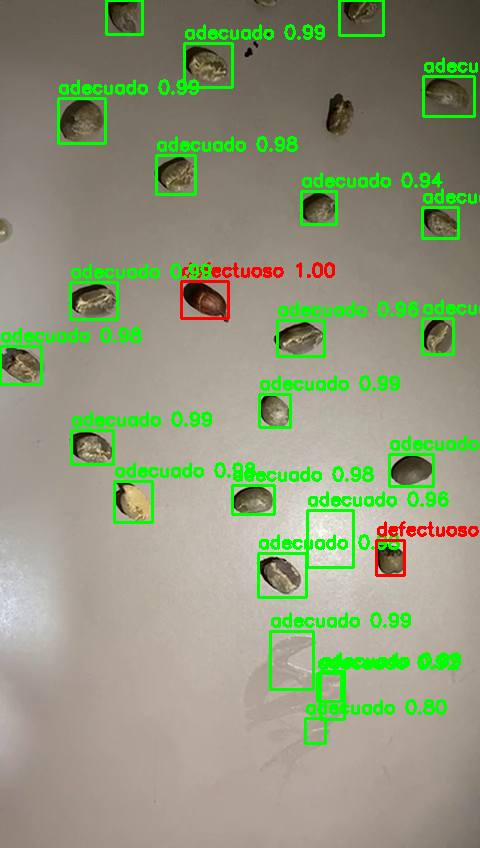

Procesando frame 60...


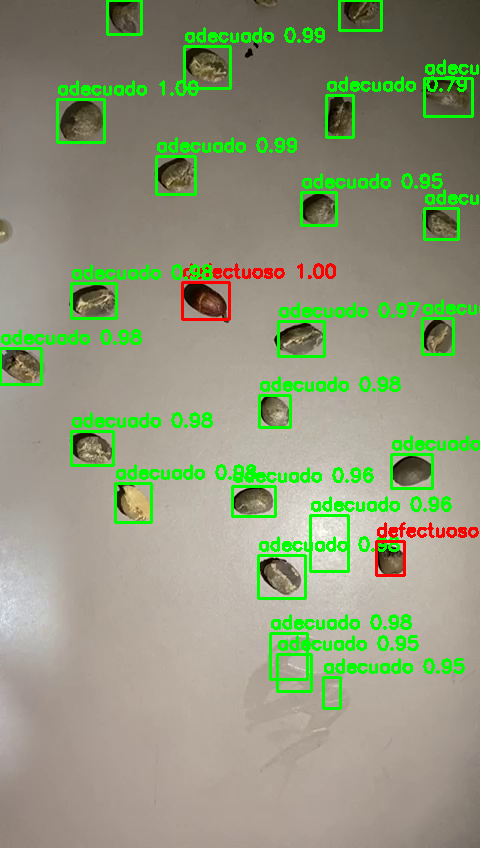

Procesando frame 61...


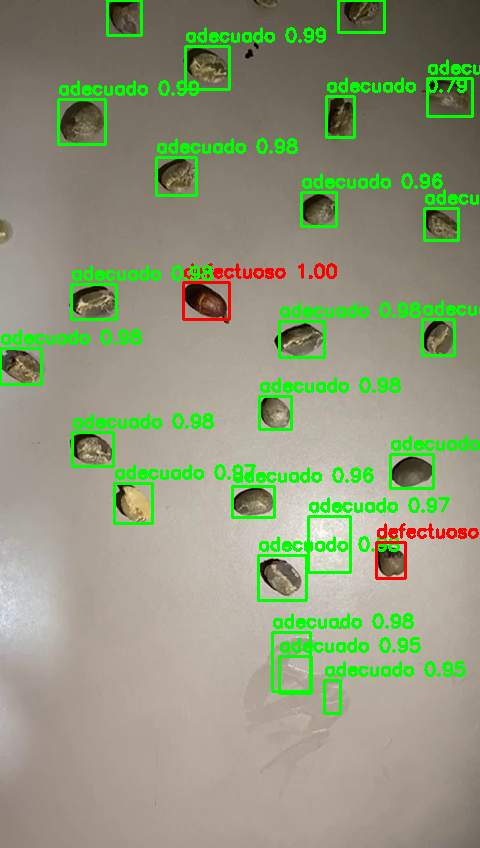

Procesando frame 62...


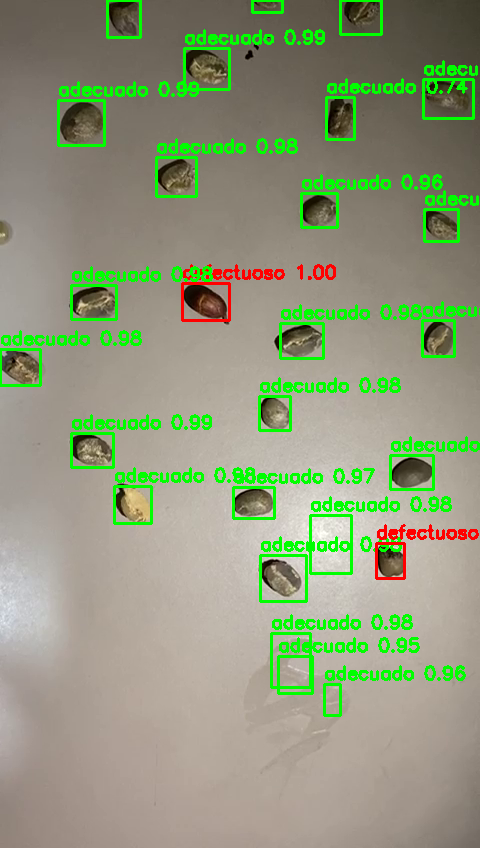

Procesando frame 63...


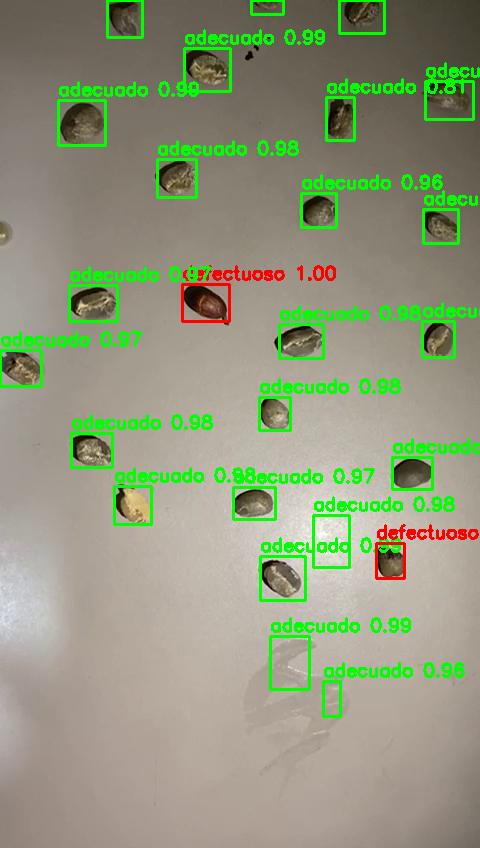

Procesando frame 64...


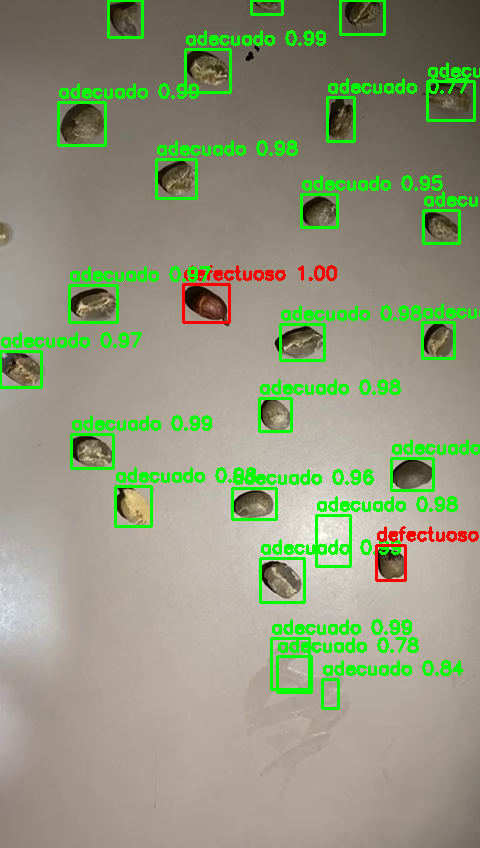

Procesando frame 65...


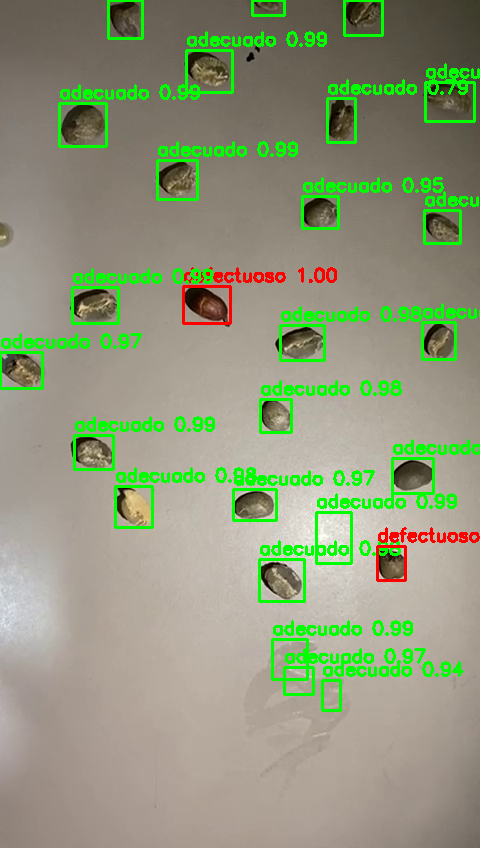

Procesando frame 66...


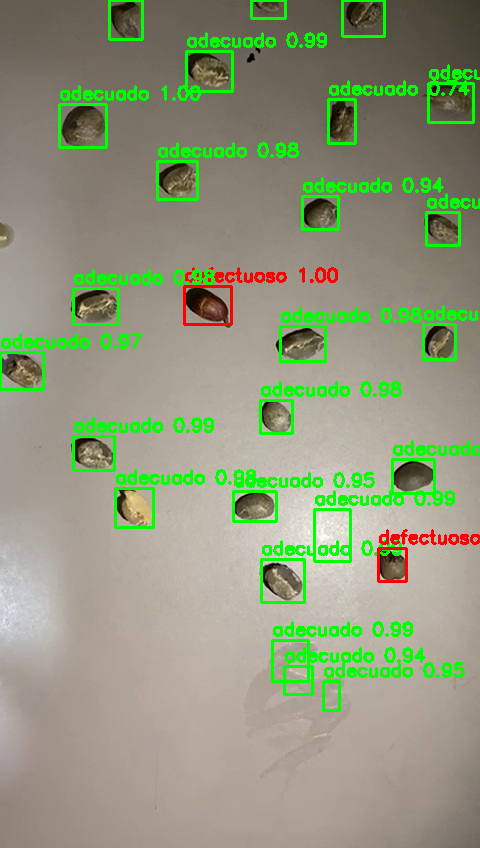

Procesando frame 67...


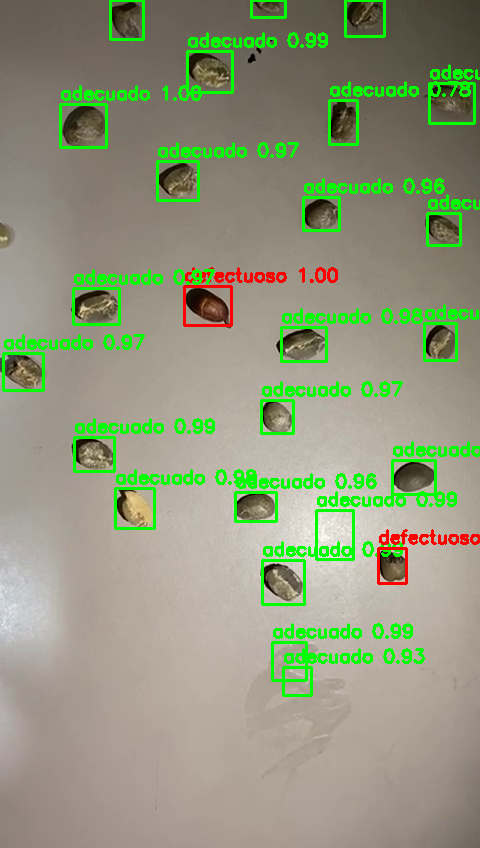

Procesando frame 68...


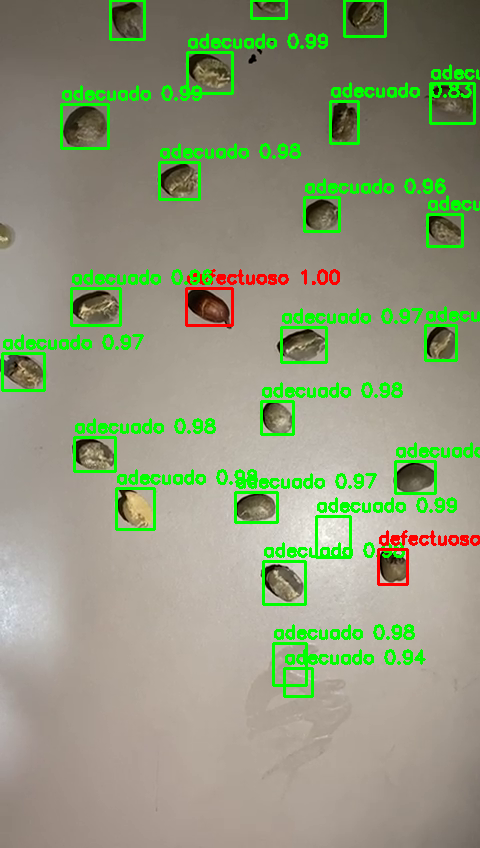

Procesando frame 69...


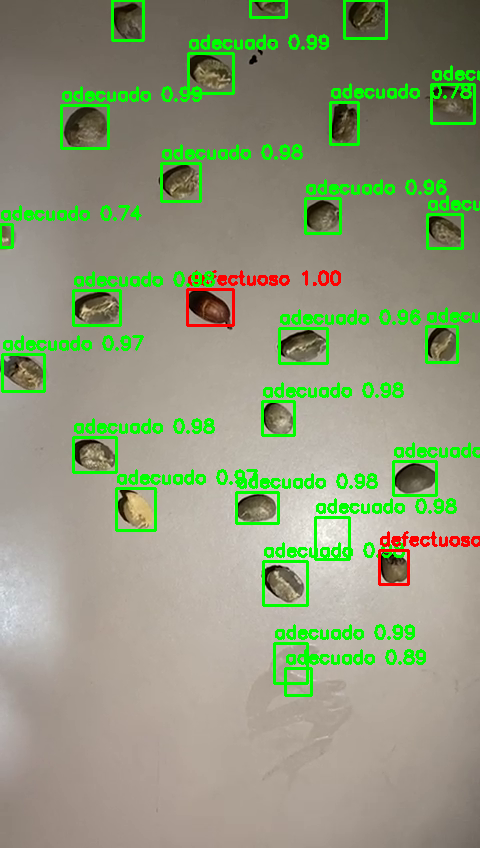

Procesando frame 70...


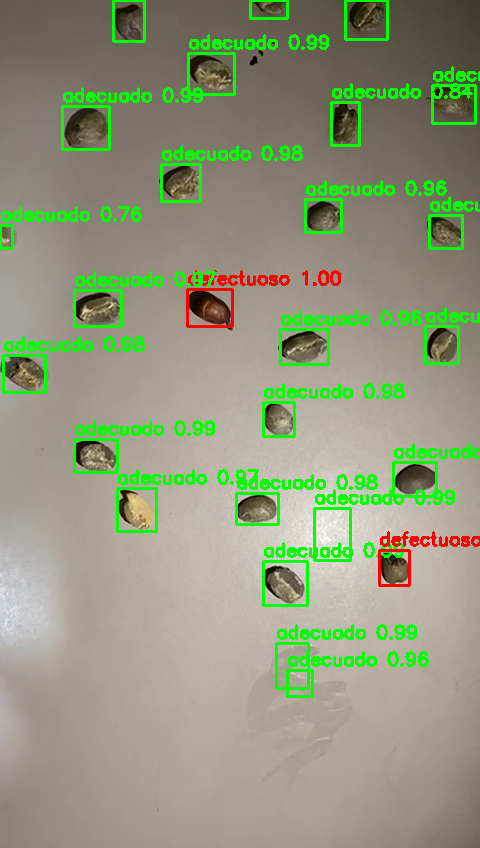

Procesando frame 71...


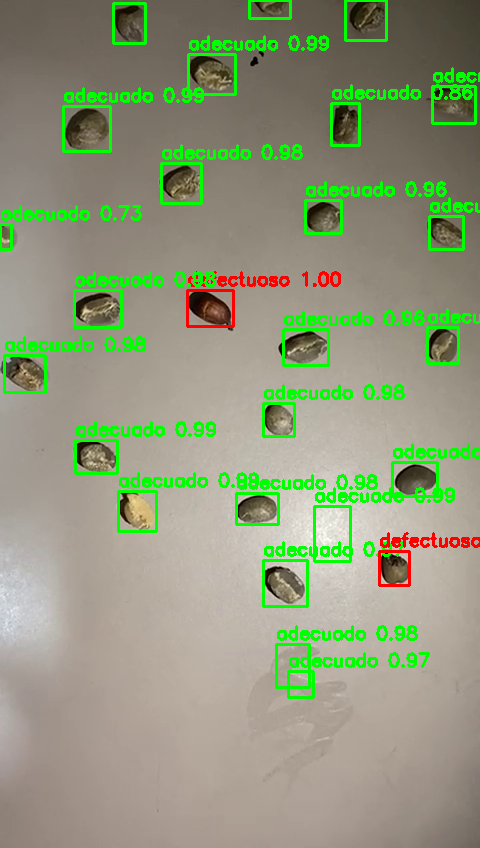

Procesando frame 72...


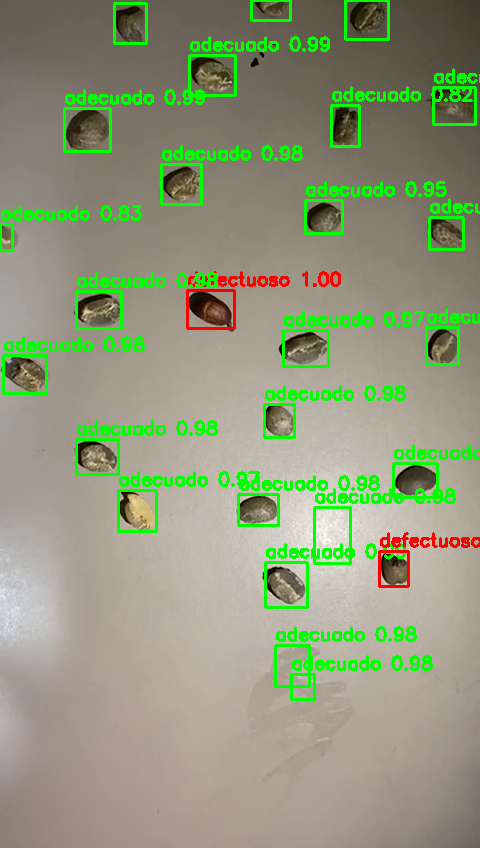

Procesando frame 73...


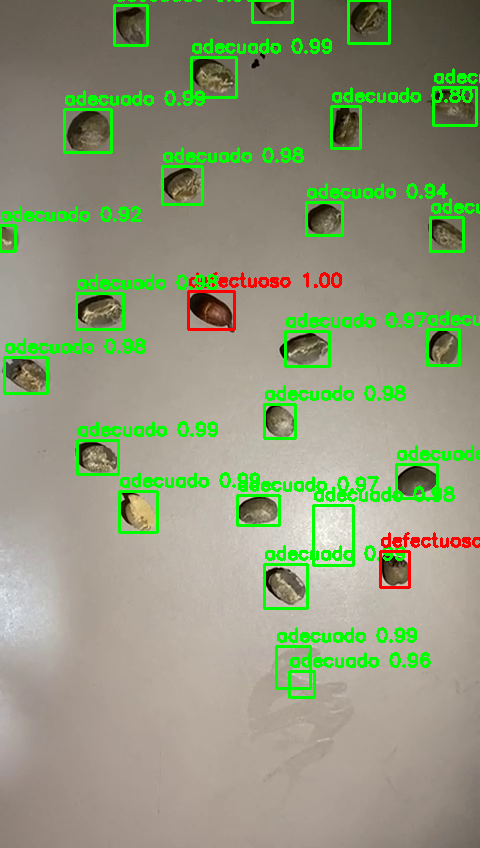

Procesando frame 74...


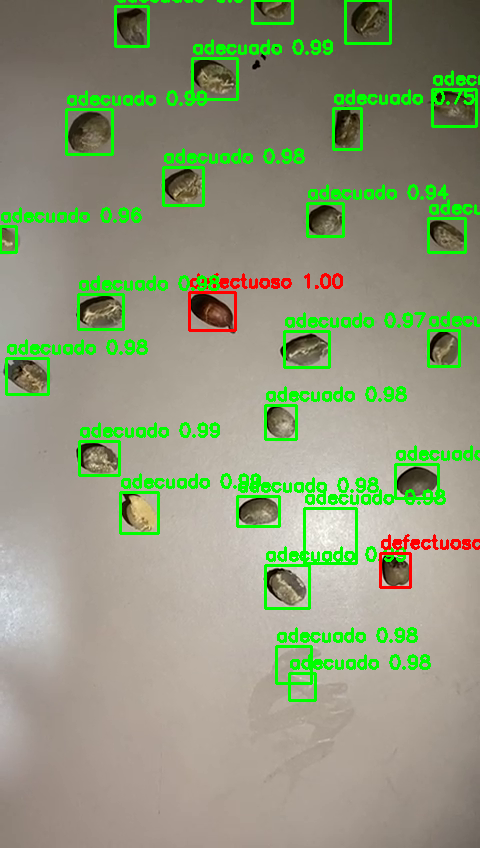

Procesando frame 75...


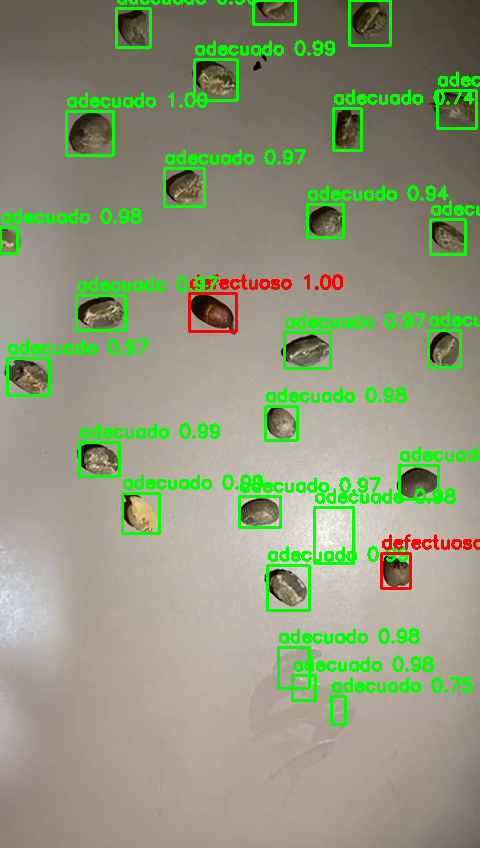

Procesando frame 76...


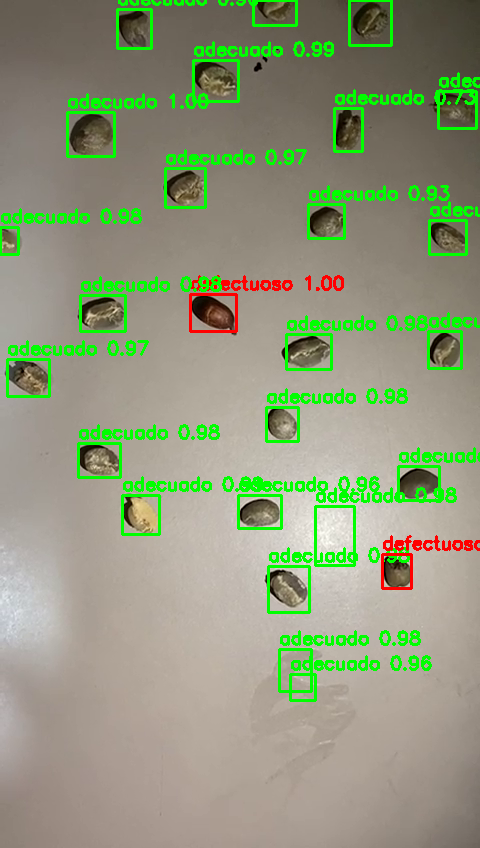

Procesando frame 77...


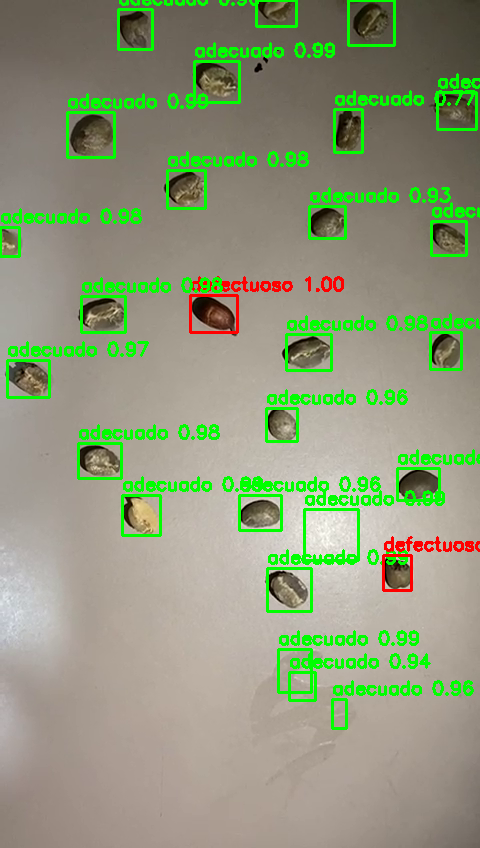

Procesando frame 78...


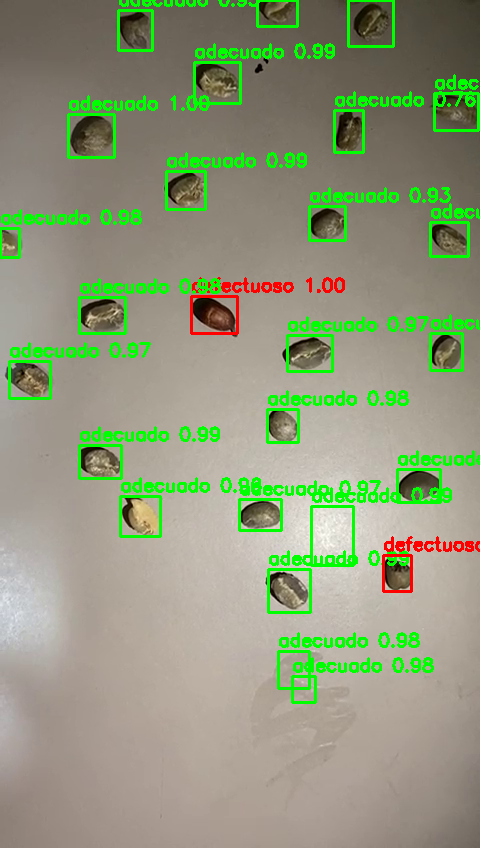

Procesando frame 79...


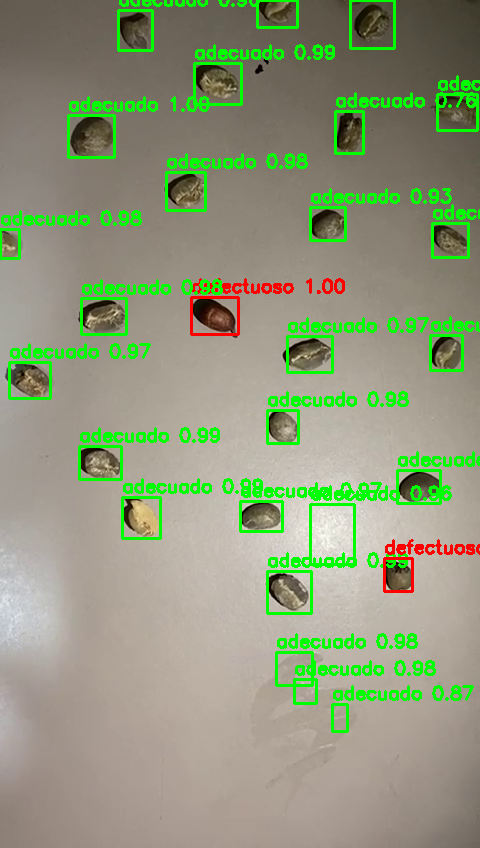

Procesando frame 80...


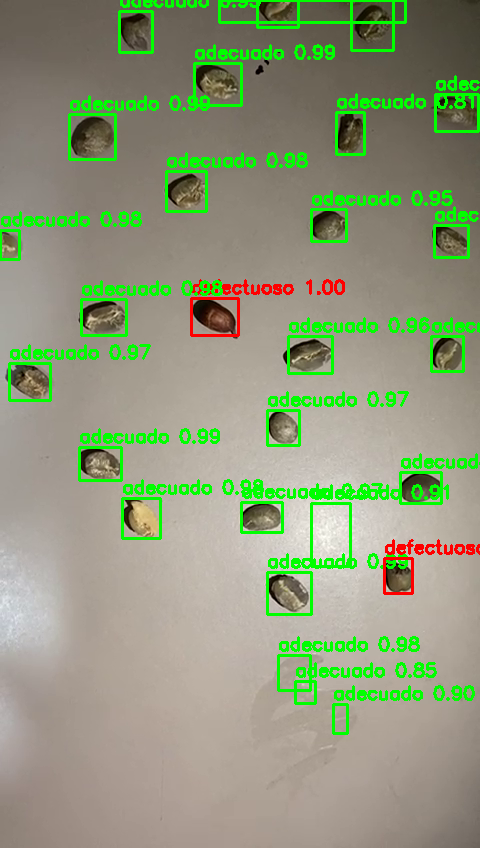

Procesando frame 81...


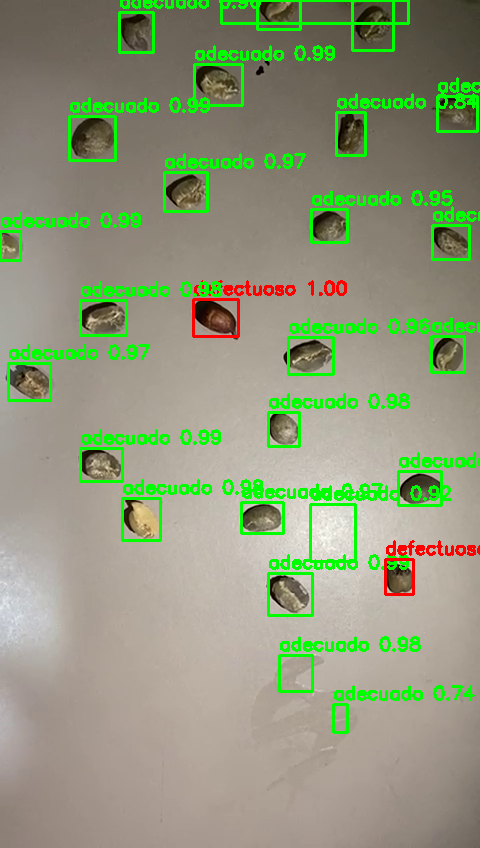

Procesando frame 82...


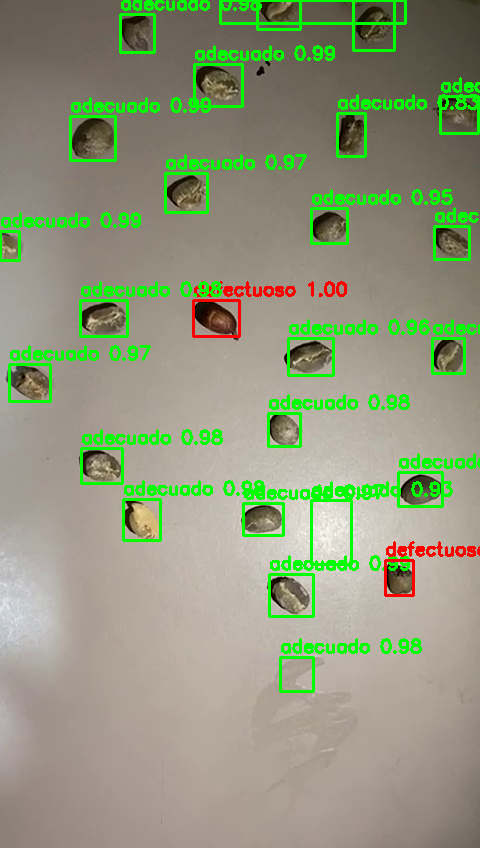

Procesando frame 83...


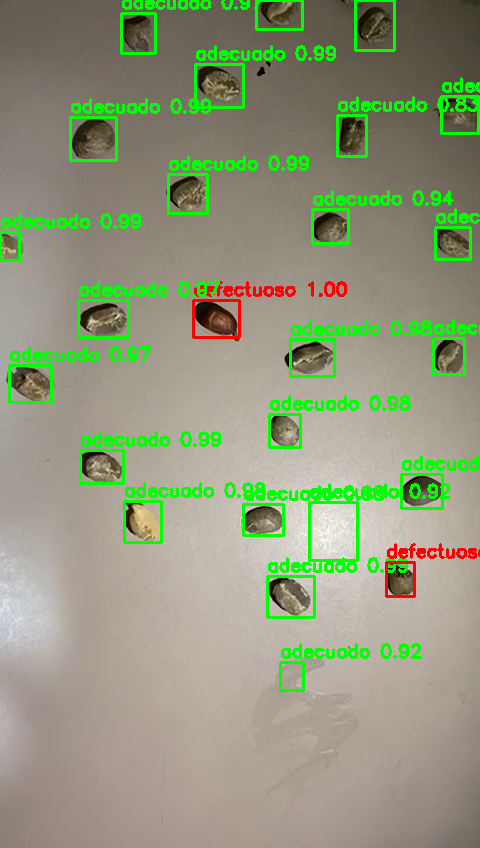

Procesando frame 84...


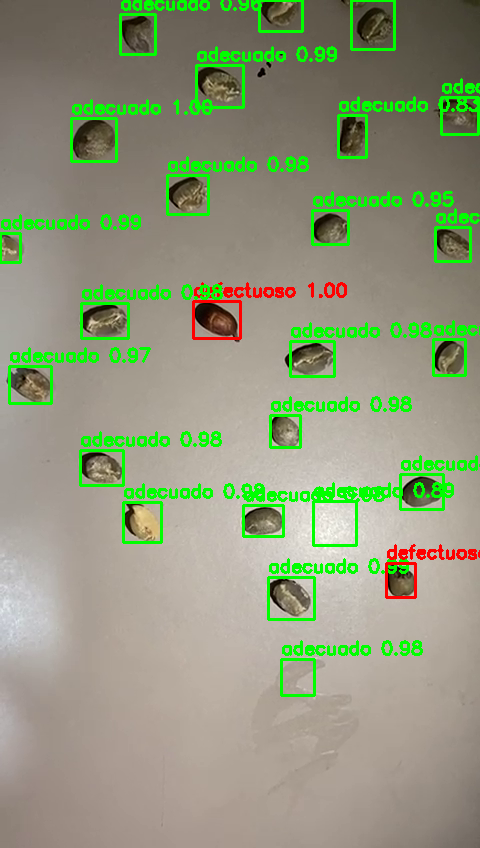

Procesando frame 85...


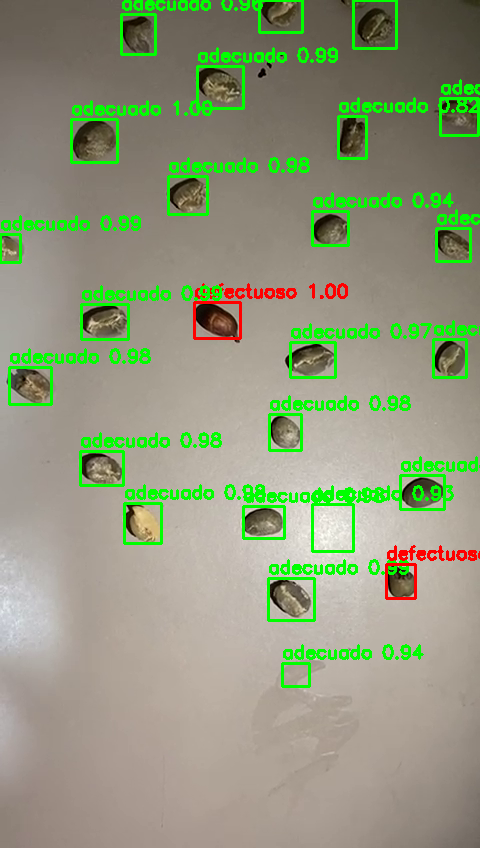

Procesando frame 86...


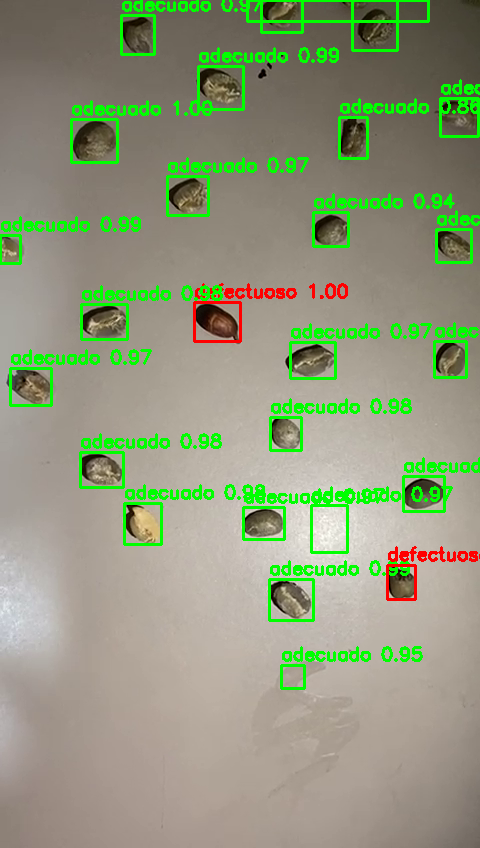

Procesando frame 87...


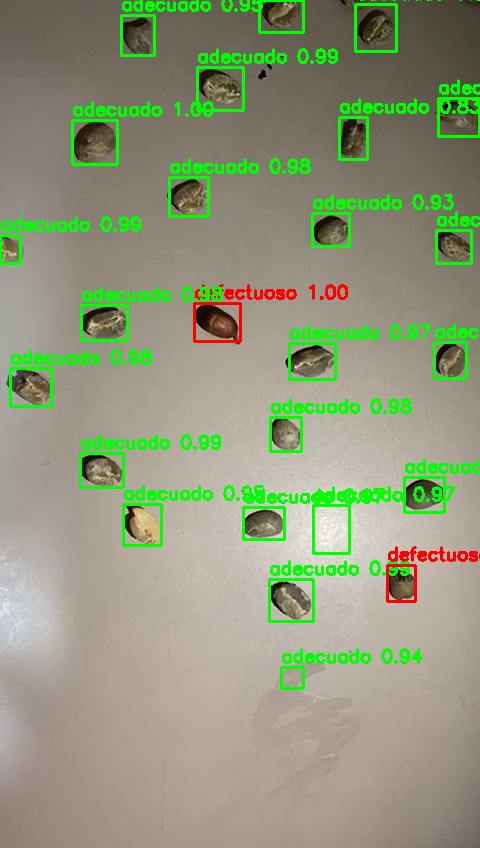

Procesando frame 88...


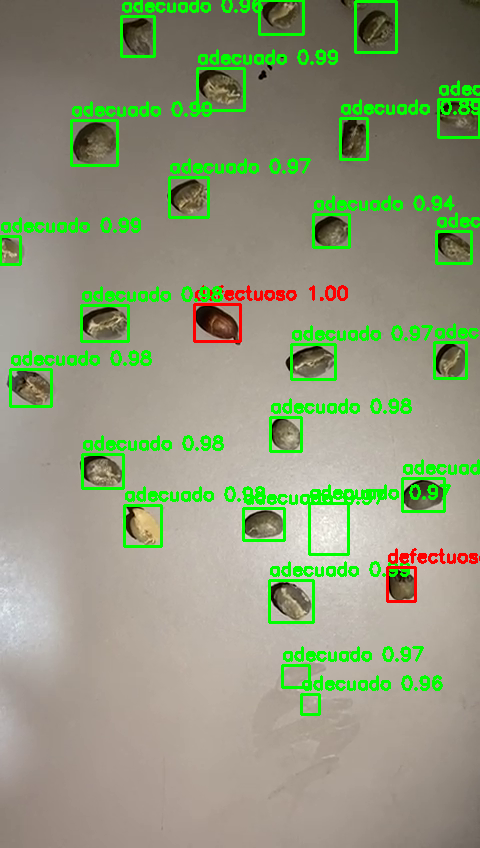

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Transformación: imagen → tensor
transform = T.Compose([T.ToTensor()])

# Ruta de tu video
video_path = "rutavideo"
cap = cv2.VideoCapture(video_path)

# Guardar video procesado
save_output = True
output_path = "/content/video_faster.mp4"

if save_output:
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    out = cv2.VideoWriter(output_path, fourcc, 20.0,
                          (int(cap.get(3)), int(cap.get(4))))

CLASSES = ["background", "adecuado", "defectuoso"]
confidence_threshold = 0.7

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1
    print(f"Procesando frame {frame_count}...")

    rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    img_tensor = transform(rgb).to(device)

    # Predicción
    with torch.no_grad():
        pred = model([img_tensor])[0]

    boxes = pred["boxes"].cpu()
    labels = pred["labels"].cpu()
    scores = pred["scores"].cpu()

    # Dibujar resultados
    for box, label, score in zip(boxes, labels, scores):
        if score < confidence_threshold:
            continue

        x1, y1, x2, y2 = map(int, box)

        cls = CLASSES[label]

        color = (0, 255, 0) if cls == "adecuado" else (0, 0, 255)

        cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
        cv2.putText(frame, f"{cls} {score:.2f}", (x1, y1 - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    # Mostrar frame en Colab
    cv2_imshow(frame)

    if save_output:
        out.write(frame)

cap.release()
if save_output:
    out.release()

print("Procesamiento terminado. Video guardado en:", output_path)
